In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

import math
import copy

import numpy as np
import gym                                          
import gym_keygrid
import pandas as pd

import matplotlib.pyplot as plt

/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/core.py:26: UserWarning: WARN: Gym minimally supports python 3.6 as the python foundation not longer supports the version, please update your version to 3.7+
  "Gym minimally supports python 3.6 as the python foundation not longer supports the version, please update your version to 3.7+"


In [2]:
%cd '/home/rmapkay/research_project'
!pip install -e ./gym-envs/gym-keygrid

/home/rmapkay/research_project
Obtaining file:///home/rmapkay/research_project/gym-envs/gym-keygrid
  Preparing metadata (setup.py) ... done
  Attempting uninstall: gym-keygrid
    Found existing installation: gym-keygrid 0.0.1
    Uninstalling gym-keygrid-0.0.1:
      Successfully uninstalled gym-keygrid-0.0.1
  Running setup.py develop for gym-keygrid


In [3]:
import gym_keygrid

In [4]:
!pip install matplotlib

In [11]:
!pip install pandas

In [12]:
!pip install gym

In [4]:
import sys
sys.path.insert(1, "../")

In [5]:
from rl_research.utils import plot_policy, plot_states, plot_qtables, plot_state_freq, plot_scores

In [14]:
pip install --upgrade pip


Cache entry deserialization failed, entry ignored
  Using cached https://files.pythonhosted.org/packages/a4/6d/6463d49a933f547439d6b5b98b46af8742cc03ae83543e4d7688c2420f8b/pip-21.3.1-py3-none-any.whl
  Found existing installation: pip 9.0.3
    Uninstalling pip-9.0.3:
      Successfully uninstalled pip-9.0.3
You are using pip version 21.3.1, however version 22.2.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [13]:

python -m venv --upgrade ./venv

[autoreload of gym_keygrid.envs.keygrid_sparse failed: Traceback (most recent call last):
  File "/home/rmapkay/Alex_env2/lib64/python3.6/site-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/home/rmapkay/Alex_env2/lib64/python3.6/site-packages/IPython/extensions/autoreload.py", line 410, in superreload
    update_generic(old_obj, new_obj)
  File "/home/rmapkay/Alex_env2/lib64/python3.6/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/home/rmapkay/Alex_env2/lib64/python3.6/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if update_generic(old_obj, new_obj): continue
  File "/home/rmapkay/Alex_env2/lib64/python3.6/site-packages/IPython/extensions/autoreload.py", line 347, in update_generic
    update(a, b)
  File "/home/rmapkay/Alex_env2/lib64/python3.6/site-packages/IPython/extensions/autoreload.py", line 302, in update_class
    if upd

ERROR: Could not find a version that satisfies the requirement python3.7 (from versions: none)
ERROR: No matching distribution found for python3.7


In [16]:
!python -m venv --upgrade ./Alex_env2

In [17]:
!python --version

Python 3.6.8


In [15]:
!pip install seaborn

In [16]:
pip install networkx

Note: you may need to restart the kernel to use updated packages.


In [17]:
pip install grakel

Note: you may need to restart the kernel to use updated packages.


In [18]:
pip install tensorflow==2.4.0

Note: you may need to restart the kernel to use updated packages.


In [19]:
pip install tensorflow-probability==0.12.2

Note: you may need to restart the kernel to use updated packages.


In [20]:
!pip install scipy

### Environment and Optimal Value Function

In [6]:
from rl_research.algorithms.temporal_difference import td_learning, q_learning

In [7]:
cd ..

/home/rmapkay


In [7]:
env = gym.make('keygrid-v0', grid_length=15)

You are using the KeyGridSparse environment with length 15


/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/envs/registration.py:594: UserWarning: WARN: The environment keygrid-v0 is out of date. You should consider upgrading to version `v1`.
  f"The environment {id} is out of date. You should consider "
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/core.py:318: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  "Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/wrappers/step_api_compatibility.py:40: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This

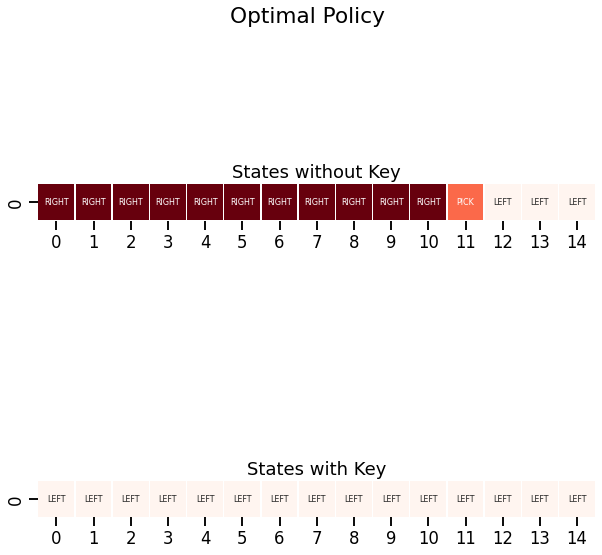

In [9]:
plot_policy(env, env.opt_policy, title="Optimal Policy")

### TD Learning using optimal policy

v_array before reshaping  [[3.73145301e-05 0.00000000e+00]
 [1.39341972e-04 4.99859559e+01]
 [4.92369881e-04 4.73728586e+01]
 [1.64375419e-03 4.45478813e+01]
 [5.17601658e-03 4.11131804e+01]
 [1.53458158e-02 3.66869594e+01]
 [4.27548186e-02 3.11682130e+01]
 [1.11709366e-01 2.48886814e+01]
 [2.73123664e-01 1.85147685e+01]
 [6.23456987e-01 1.27655928e+01]
 [1.32561747e+00 8.13996198e+00]
 [2.61932947e+00 4.79936639e+00]
 [0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00]] shape  (15, 2)
after transpose  [[3.73145301e-05 1.39341972e-04 4.92369881e-04 1.64375419e-03
  5.17601658e-03 1.53458158e-02 4.27548186e-02 1.11709366e-01
  2.73123664e-01 6.23456987e-01 1.32561747e+00 2.61932947e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 4.99859559e+01 4.73728586e+01 4.45478813e+01
  4.11131804e+01 3.66869594e+01 3.11682130e+01 2.48886814e+01
  1.85147685e+01 1.27655928e+01 8.13996198e+00 4.79936639e+00
  0.00000000e+00 0.0000000

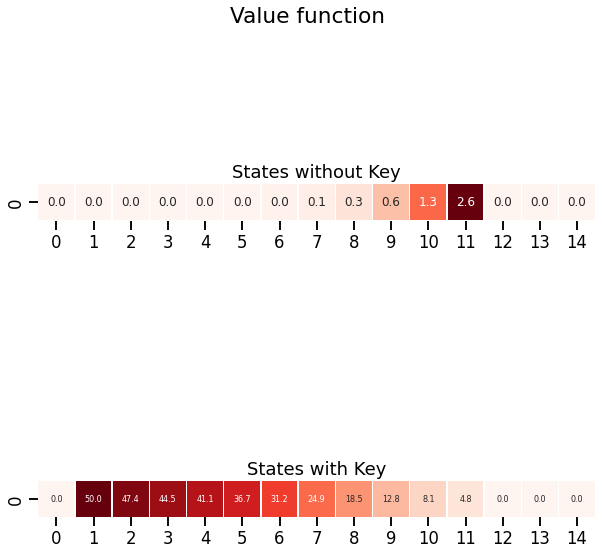

In [114]:
v_array = td_learning(env.opt_policy, env, display=False)
print('hey ',v_array[1].shape)
_ = plot_states(v_array, annot=v_array, title="Value function")

In [19]:
v_array

array([[[3.73145301e-05, 1.39341972e-04, 4.92369881e-04, 1.64375419e-03,
         5.17601658e-03, 1.53458158e-02, 4.27548186e-02, 1.11709366e-01,
         2.73123664e-01, 6.23456987e-01, 1.32561747e+00, 2.61932947e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

       [[0.00000000e+00, 4.99859559e+01, 4.73728586e+01, 4.45478813e+01,
         4.11131804e+01, 3.66869594e+01, 3.11682130e+01, 2.48886814e+01,
         1.85147685e+01, 1.27655928e+01, 8.13996198e+00, 4.79936639e+00,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00]]])

### Q Learning 

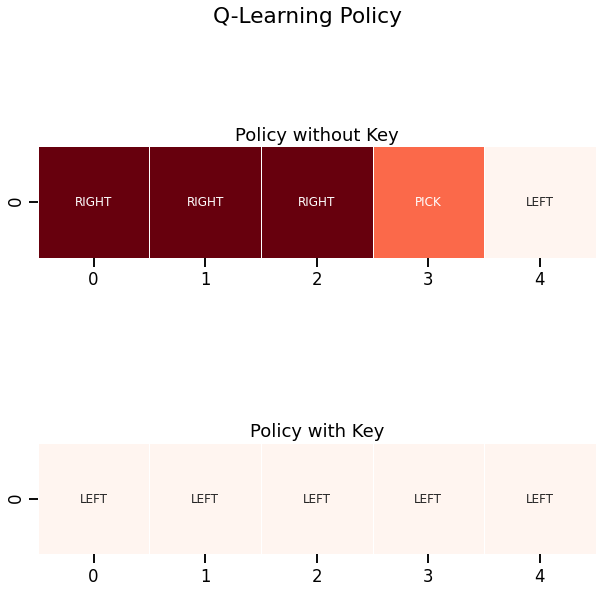

In [38]:
q_table = q_learning(env, display=False, num_episodes=50000)
q_policy = {x: env.actions[np.argmax(q_table[x])] for x in env.states}
_ = plot_policy(env, q_policy, "Q-Learning Policy")

### Genetic Algorithm

In [9]:
from rl_research.algorithms.genetic_algo import train, get_best_agent

In [53]:
best_agents = train(env, 400)


****************************************************************************************************
TRAINING START

Generation: 1 Score: 0
Generation: 2 Score: 0
Generation: 3 Score: 0
Generation: 4 Score: 0
Generation: 5 Score: 0
Generation: 6 Score: 0
Generation: 7 Score: 0
Generation: 8 Score: 0
Generation: 9 Score: 0
Generation: 10 Score: 0
Generation: 11 Score: 0
Generation: 12 Score: 0
Generation: 13 Score: 0
Generation: 14 Score: 0
Generation: 15 Score: 0
Generation: 16 Score: 0
Generation: 17 Score: 0
Generation: 18 Score: 0
Generation: 19 Score: 0
Generation: 20 Score: 0
Generation: 21 Score: 0
Generation: 22 Score: 0
Generation: 23 Score: 0
Generation: 24 Score: 0
Generation: 25 Score: 0
Generation: 26 Score: 0
Generation: 27 Score: 0
Generation: 28 Score: 0
Generation: 29 Score: 0
Generation: 30 Score: 0
Generation: 31 Score: 0
Generation: 32 Score: 0
Generation: 33 Score: 0
Generation: 34 Score: 0
Generation: 35 Score: 0
Generation: 36 Score: 0
Generation: 37 Score: 0
Gen

Generation: 324 Score: 50
Generation: 325 Score: 50
Generation: 326 Score: 50
Generation: 327 Score: 50
Generation: 328 Score: 50
Generation: 329 Score: 50
Generation: 330 Score: 50
Generation: 331 Score: 50
Generation: 332 Score: 50
Generation: 333 Score: 50
Generation: 334 Score: 50
Generation: 335 Score: 50
Generation: 336 Score: 50
Generation: 337 Score: 50
Generation: 338 Score: 50
Generation: 339 Score: 50
Generation: 340 Score: 50
Generation: 341 Score: 50
Generation: 342 Score: 50
Generation: 343 Score: 50
Generation: 344 Score: 50
Generation: 345 Score: 50
Generation: 346 Score: 50
Generation: 347 Score: 50
Generation: 348 Score: 50
Generation: 349 Score: 50
Generation: 350 Score: 50
Generation: 351 Score: 50
Generation: 352 Score: 50
Generation: 353 Score: 50
Generation: 354 Score: 50
Generation: 355 Score: 50
Generation: 356 Score: 50
Generation: 357 Score: 50
Generation: 358 Score: 50
Generation: 359 Score: 50
Generation: 360 Score: 50
Generation: 361 Score: 50
Generation: 

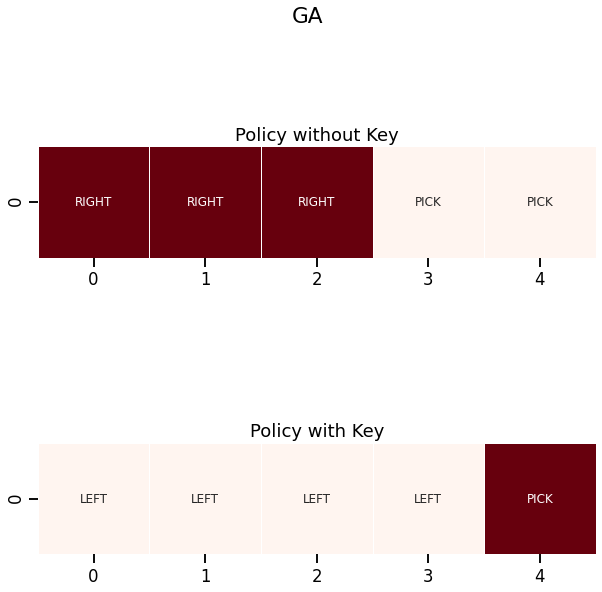

In [54]:
policy  = {x: get_best_agent(best_agents).get_action(x) for x in env.states}
plot_policy(env, policy, "GA")

### ES Algorithm

In [56]:
from rl_research.algorithms.env_strat import train

In [57]:
agent = train(env)


****************************************************************************************************
TRAINING START

(array([0.]), array([100]))
Generation: 0 Score: 0
(array([0.]), array([100]))
Generation: 1 Score: 0
(array([0.]), array([100]))
Generation: 2 Score: 0
(array([0.]), array([100]))
Generation: 3 Score: 0
(array([0.]), array([100]))
Generation: 4 Score: 0
(array([0.]), array([100]))
Generation: 5 Score: 0
(array([0.]), array([100]))
Generation: 6 Score: 0
(array([0.]), array([100]))
Generation: 7 Score: 0
(array([0.]), array([100]))
Generation: 8 Score: 0
(array([0.]), array([100]))
Generation: 9 Score: 0
(array([0.]), array([100]))
Generation: 10 Score: 0
(array([0.]), array([100]))
Generation: 11 Score: 0
(array([0.]), array([100]))
Generation: 12 Score: 0
(array([0.]), array([100]))
Generation: 13 Score: 0
(array([0.]), array([100]))
Generation: 14 Score: 0
(array([0.]), array([100]))
Generation: 15 Score: 0
(array([0.]), array([100]))
Generation: 16 Score: 0
(array([

(array([ 0., 50.]), array([81, 19]))
Generation: 150 Score: 50
(array([ 0., 50.]), array([83, 17]))
Generation: 151 Score: 0
(array([ 0., 50.]), array([81, 19]))
Generation: 152 Score: 50
(array([ 0., 50.]), array([89, 11]))
Generation: 153 Score: 50
(array([ 0., 50.]), array([84, 16]))
Generation: 154 Score: 50
(array([ 0., 50.]), array([78, 22]))
Generation: 155 Score: 0
(array([ 0., 50.]), array([74, 26]))
Generation: 156 Score: 50
(array([ 0., 50.]), array([75, 25]))
Generation: 157 Score: 50
(array([ 0., 50.]), array([79, 21]))
Generation: 158 Score: 50
(array([ 0., 50.]), array([81, 19]))
Generation: 159 Score: 0
(array([ 0., 50.]), array([79, 21]))
Generation: 160 Score: 50
(array([ 0., 50.]), array([70, 30]))
Generation: 161 Score: 0
(array([ 0., 50.]), array([75, 25]))
Generation: 162 Score: 50
(array([ 0., 50.]), array([62, 38]))
Generation: 163 Score: 0
(array([ 0., 50.]), array([74, 26]))
Generation: 164 Score: 50
(array([ 0., 50.]), array([73, 27]))
Generation: 165 Score: 

(array([ 0., 50.]), array([59, 41]))
Generation: 282 Score: 0
(array([ 0., 50.]), array([62, 38]))
Generation: 283 Score: 0
(array([ 0., 50.]), array([57, 43]))
Generation: 284 Score: 0
(array([ 0., 50.]), array([80, 20]))
Generation: 285 Score: 50
(array([ 0., 50.]), array([34, 66]))
Generation: 286 Score: 0
(array([ 0., 50.]), array([85, 15]))
Generation: 287 Score: 50
(array([ 0., 50.]), array([14, 86]))
Generation: 288 Score: 0
(array([ 0., 50.]), array([60, 40]))
Generation: 289 Score: 0
(array([ 0., 50.]), array([63, 37]))
Generation: 290 Score: 50
(array([ 0., 50.]), array([38, 62]))
Generation: 291 Score: 0
(array([ 0., 50.]), array([69, 31]))
Generation: 292 Score: 50
(array([ 0., 50.]), array([43, 57]))
Generation: 293 Score: 0
(array([ 0., 50.]), array([64, 36]))
Generation: 294 Score: 50
(array([ 0., 50.]), array([48, 52]))
Generation: 295 Score: 50
(array([ 0., 50.]), array([23, 77]))
Generation: 296 Score: 0
(array([ 0., 50.]), array([64, 36]))
Generation: 297 Score: 50
(

In [113]:
agent.get_policy()
agent.policy
plot_policy(env, agent.policy, "ES")

NameError: name 'agent' is not defined

### REINFORCE

In [10]:
from rl_research.algorithms.reinforce_baseline import ReinforceBaseline
from rl_research.algorithms.reinforce_count_states import ReinforceCountState
from rl_research.algorithms.reinforce_count_states_actions import ReinforceCountStateAction
from rl_research.algorithms.reinforce_count_seq import ReinforceCountSeq
from rl_research.algorithms.reinforce_count_seq_edited import ReinforceCountSeqEdited
from rl_research.algorithms.training import train

L = 6000
logs = True
beta=0.9

In [6]:
cd ..

/home/rmapkay/research_project


episode:  0


/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:175: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  "Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:191: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting.
  "Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:196: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `options` to allow the en

episode:  1
episode:  2
episode:  3
episode:  4
episode:  5
episode:  6
episode:  7
episode:  8
episode:  9
episode:  10
episode:  11
episode:  12
episode:  13
episode:  14
episode:  15
episode:  16
episode:  17
episode:  18
episode:  19
episode:  20
episode:  21
episode:  22
episode:  23
episode:  24
episode:  25
episode:  26
episode:  27
episode:  28
episode:  29
episode:  30
episode:  31
episode:  32
episode:  33
episode:  34
episode:  35
episode:  36
episode:  37
episode:  38
episode:  39
episode:  40
episode:  41
episode:  42
episode:  43
episode:  44
episode:  45
episode:  46
episode:  47
episode:  48
episode:  49
episode:  50
episode:  51
episode:  52
episode:  53
episode:  54
episode:  55
episode:  56
episode:  57
episode:  58
episode:  59
episode:  60
episode:  61
episode:  62
episode:  63
episode:  64
episode:  65
episode:  66
episode:  67
episode:  68
episode:  69
episode:  70
episode:  71
episode:  72
episode:  73
episode:  74
episode:  75
episode:  76
episode:  77
episode:

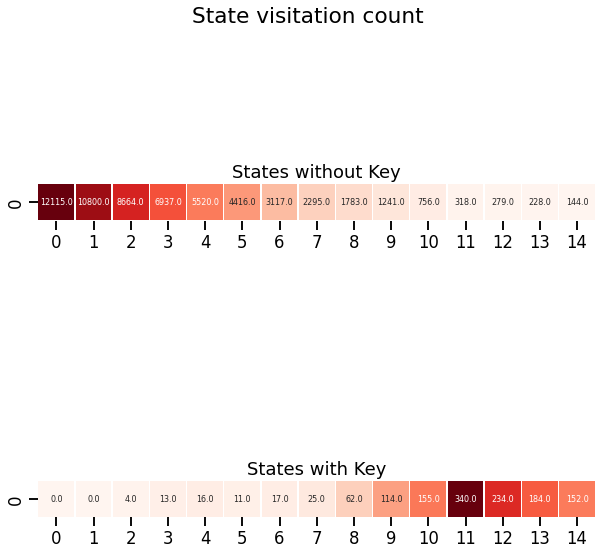

episode:  1000
episode:  1001
episode:  1002
episode:  1003
episode:  1004
episode:  1005
episode:  1006
episode:  1007
episode:  1008
episode:  1009
episode:  1010
episode:  1011
episode:  1012
episode:  1013
episode:  1014
episode:  1015
episode:  1016
episode:  1017
episode:  1018
episode:  1019
episode:  1020
episode:  1021
episode:  1022
episode:  1023
episode:  1024
episode:  1025
episode:  1026
episode:  1027
episode:  1028
episode:  1029
episode:  1030
episode:  1031
episode:  1032
episode:  1033
episode:  1034
episode:  1035
episode:  1036
episode:  1037
episode:  1038
episode:  1039
episode:  1040
episode:  1041
episode:  1042
episode:  1043
episode:  1044
episode:  1045
episode:  1046
episode:  1047
episode:  1048
episode:  1049
episode:  1050
episode:  1051
episode:  1052
episode:  1053
episode:  1054
episode:  1055
episode:  1056
episode:  1057
episode:  1058
episode:  1059
episode:  1060
episode:  1061
episode:  1062
episode:  1063
episode:  1064
episode:  1065
episode:  

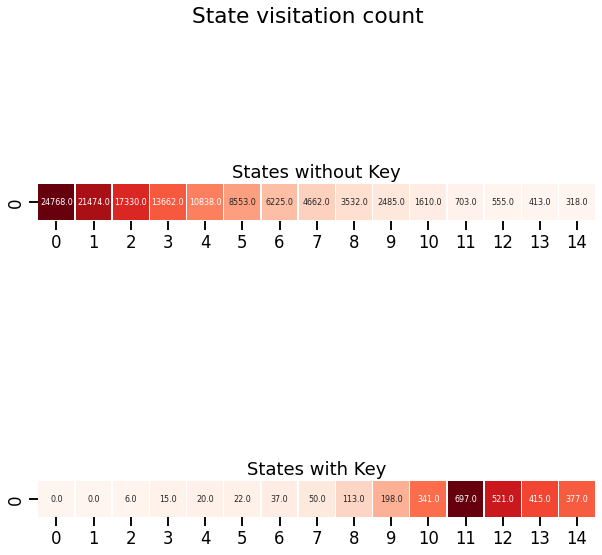

episode:  2000
episode:  2001
episode:  2002
episode:  2003
episode:  2004
episode:  2005
episode:  2006
episode:  2007
episode:  2008
episode:  2009
episode:  2010
episode:  2011
episode:  2012
episode:  2013
episode:  2014
episode:  2015
episode:  2016
episode:  2017
episode:  2018
episode:  2019
episode:  2020
episode:  2021
episode:  2022
episode:  2023
episode:  2024
episode:  2025
episode:  2026
episode:  2027
episode:  2028
episode:  2029
episode:  2030
episode:  2031
episode:  2032
episode:  2033
episode:  2034
episode:  2035
episode:  2036
episode:  2037
episode:  2038
episode:  2039
episode:  2040
episode:  2041
episode:  2042
episode:  2043
episode:  2044
episode:  2045
episode:  2046
episode:  2047
episode:  2048
episode:  2049
episode:  2050
episode:  2051
episode:  2052
episode:  2053
episode:  2054
episode:  2055
episode:  2056
episode:  2057
episode:  2058
episode:  2059
episode:  2060
episode:  2061
episode:  2062
episode:  2063
episode:  2064
episode:  2065
episode:  

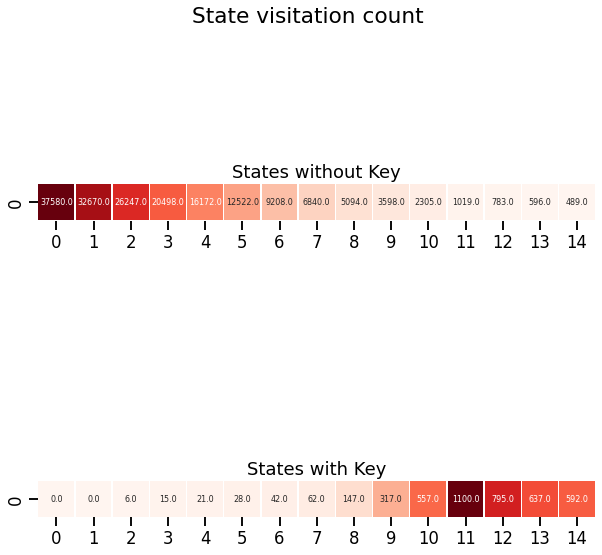

episode:  3000
episode:  3001
episode:  3002
episode:  3003
episode:  3004
episode:  3005
episode:  3006
episode:  3007
episode:  3008
episode:  3009
episode:  3010
episode:  3011
episode:  3012
episode:  3013
episode:  3014
episode:  3015
episode:  3016
episode:  3017
episode:  3018
episode:  3019
episode:  3020
episode:  3021
episode:  3022
episode:  3023
episode:  3024
episode:  3025
episode:  3026
episode:  3027
episode:  3028
episode:  3029
episode:  3030
episode:  3031
episode:  3032
episode:  3033
episode:  3034
episode:  3035
episode:  3036
episode:  3037
episode:  3038
episode:  3039
episode:  3040
episode:  3041
episode:  3042
episode:  3043
episode:  3044
episode:  3045
episode:  3046
episode:  3047
episode:  3048
episode:  3049
episode:  3050
episode:  3051
episode:  3052
episode:  3053
episode:  3054
episode:  3055
episode:  3056
episode:  3057
episode:  3058
episode:  3059
episode:  3060
episode:  3061
episode:  3062
episode:  3063
episode:  3064
episode:  3065
episode:  

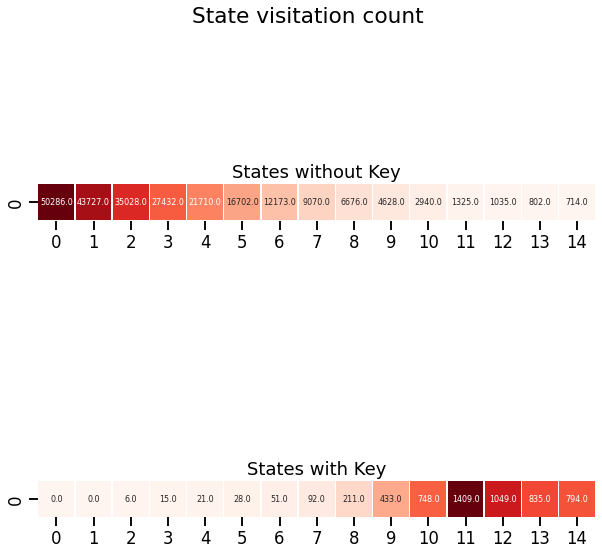

episode:  4000
episode:  4001
episode:  4002
episode:  4003
episode:  4004
episode:  4005
episode:  4006
episode:  4007
episode:  4008
episode:  4009
episode:  4010
episode:  4011
episode:  4012
episode:  4013
episode:  4014
episode:  4015
episode:  4016
episode:  4017
episode:  4018
episode:  4019
episode:  4020
episode:  4021
episode:  4022
episode:  4023
episode:  4024
episode:  4025
episode:  4026
episode:  4027
episode:  4028
episode:  4029
episode:  4030
episode:  4031
episode:  4032
episode:  4033
episode:  4034
episode:  4035
episode:  4036
episode:  4037
episode:  4038
episode:  4039
episode:  4040
episode:  4041
episode:  4042
episode:  4043
episode:  4044
episode:  4045
episode:  4046
episode:  4047
episode:  4048
episode:  4049
episode:  4050
episode:  4051
episode:  4052
episode:  4053
episode:  4054
episode:  4055
episode:  4056
episode:  4057
episode:  4058
episode:  4059
episode:  4060
episode:  4061
episode:  4062
episode:  4063
episode:  4064
episode:  4065
episode:  

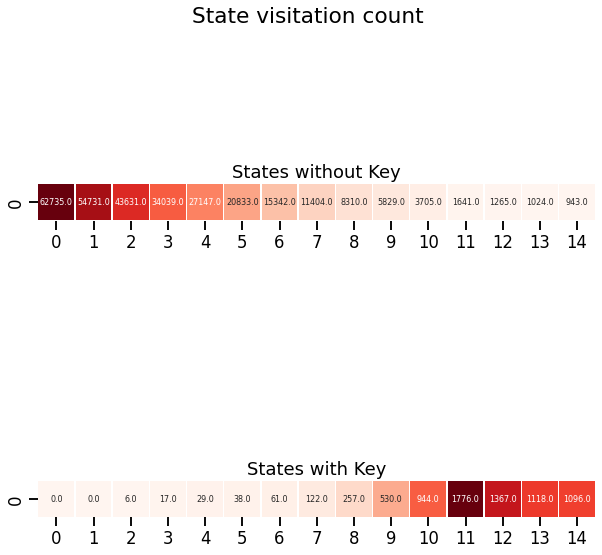

episode:  5000
episode:  5001
episode:  5002
episode:  5003
episode:  5004
episode:  5005
episode:  5006
episode:  5007
episode:  5008
episode:  5009
episode:  5010
episode:  5011
episode:  5012
episode:  5013
episode:  5014
episode:  5015
episode:  5016
episode:  5017
episode:  5018
episode:  5019
episode:  5020
episode:  5021
episode:  5022
episode:  5023
episode:  5024
episode:  5025
episode:  5026
episode:  5027
episode:  5028
episode:  5029
episode:  5030
episode:  5031
episode:  5032
episode:  5033
episode:  5034
episode:  5035
episode:  5036
episode:  5037
episode:  5038
episode:  5039
episode:  5040
episode:  5041
episode:  5042
episode:  5043
episode:  5044
episode:  5045
episode:  5046
episode:  5047
episode:  5048
episode:  5049
episode:  5050
episode:  5051
episode:  5052
episode:  5053
episode:  5054
episode:  5055
episode:  5056
episode:  5057
episode:  5058
episode:  5059
episode:  5060
episode:  5061
episode:  5062
episode:  5063
episode:  5064
episode:  5065
episode:  

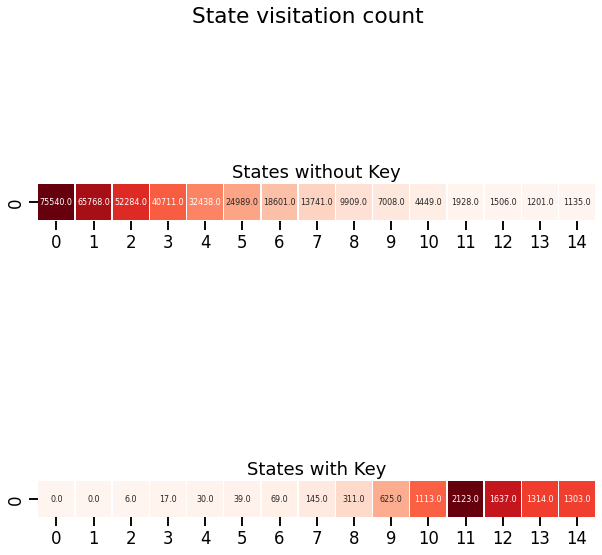

In [12]:
agent_reinforce=train(env,ReinforceBaseline,L,logs,beta) #observe wha


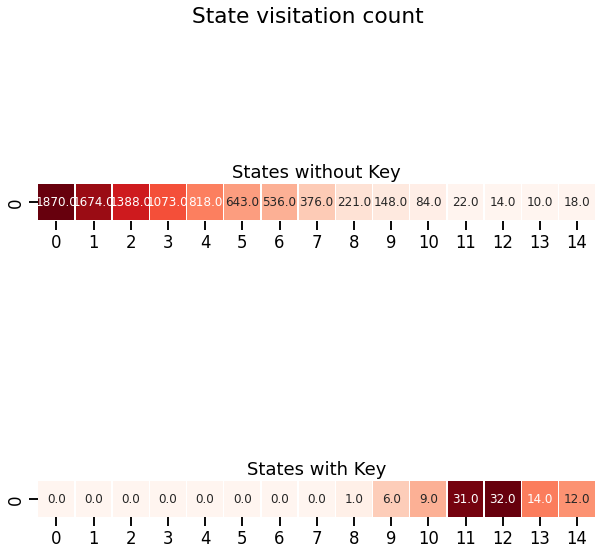

In [111]:
#heatmap
state_freq_array = np.zeros(env.states_n).T
list1=[]
list2=[]
for key in agent_reinforce.state_freq.keys():
    if key[1]==0:
        list1.append(agent_reinforce.state_freq[key])
        
    else:
        list2.append(agent_reinforce.state_freq[key])
array1 = np.array(list1)
array2 = np.array(list2)
state_freq_array[0]=array1
state_freq_array[1]=array2
array=state_freq_array.reshape((2, -1, env.len), order='F')
_ = plot_states(array, annot=array,title="State visitation count")

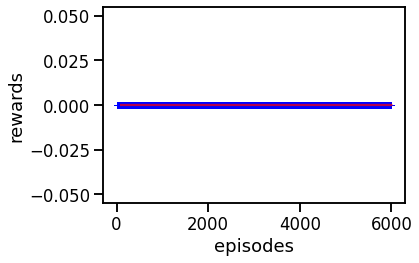

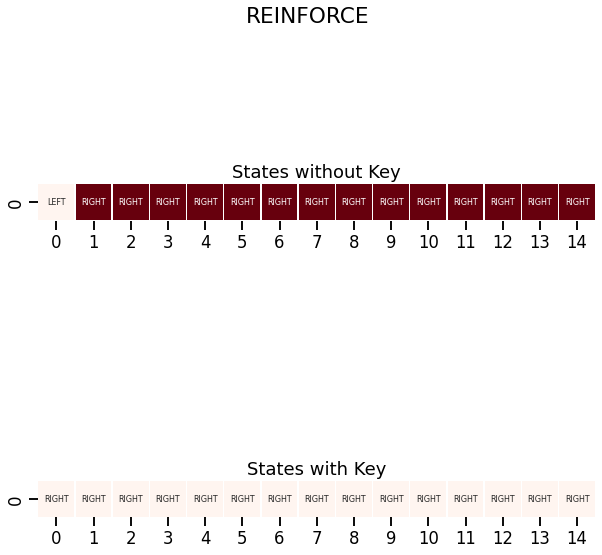

{(0, 0): array([0.3335882 , 0.33337   , 0.33304182], dtype=float32),
 (0, 1): array([0.302528  , 0.34312314, 0.35434887], dtype=float32),
 (1, 0): array([0.3321998 , 0.33362335, 0.33417684], dtype=float32),
 (1, 1): array([0.3011413 , 0.34406337, 0.35479528], dtype=float32),
 (2, 0): array([0.3306897 , 0.334159  , 0.33515137], dtype=float32),
 (2, 1): array([0.29972038, 0.3452366 , 0.35504302], dtype=float32),
 (3, 0): array([0.32917944, 0.3346995 , 0.33612108], dtype=float32),
 (3, 1): array([0.29815957, 0.34649011, 0.35535035], dtype=float32),
 (4, 0): array([0.32767233, 0.3352378 , 0.33708984], dtype=float32),
 (4, 1): array([0.29657263, 0.34749967, 0.35592777], dtype=float32),
 (5, 0): array([0.3261683, 0.3357733, 0.3380584], dtype=float32),
 (5, 1): array([0.2952614 , 0.3484362 , 0.35630235], dtype=float32),
 (6, 0): array([0.32466477, 0.33630553, 0.33902976], dtype=float32),
 (6, 1): array([0.29415303, 0.34944645, 0.3564005 ], dtype=float32),
 (7, 0): array([0.3231612 , 0.3368362

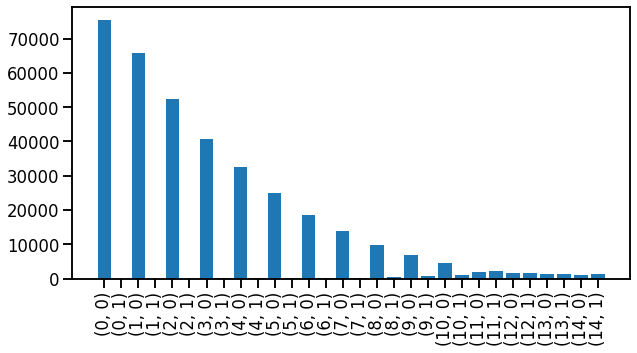

In [13]:
plot_scores(agent_reinforce.scores)
agent_reinforce.get_policy()
plot_policy(env, agent_reinforce.pi, "REINFORCE")
plot_state_freq(agent_reinforce.state_freq)
agent_reinforce.get_proba()

episode:  0
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | *

/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/core.py:50: DeprecationWarning: WARN: You are calling render method, but you didn't specified the argument render_mode at environment initialization. To maintain backward compatibility, the environment will render in human mode.
If you want to render in human mode, initialize the environment in this way: gym.make('EnvName', render_mode='human') and don't call the render method.
See here for more information: https://www.gymlibrary.ml/content/api/
  "You are calling render method, "


episode:  1
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | *

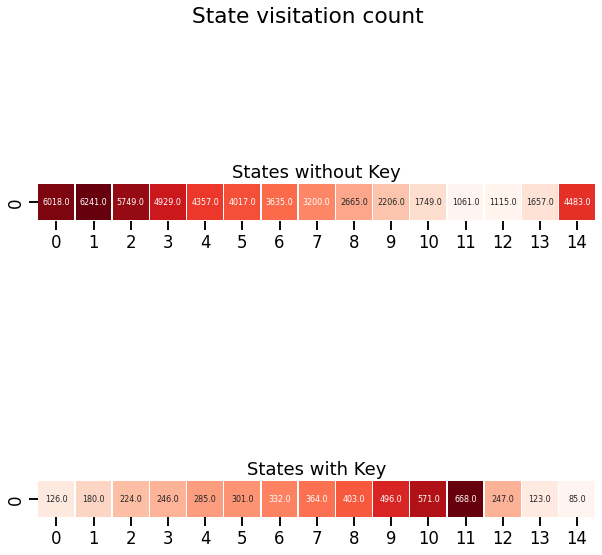

| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | K | A | *

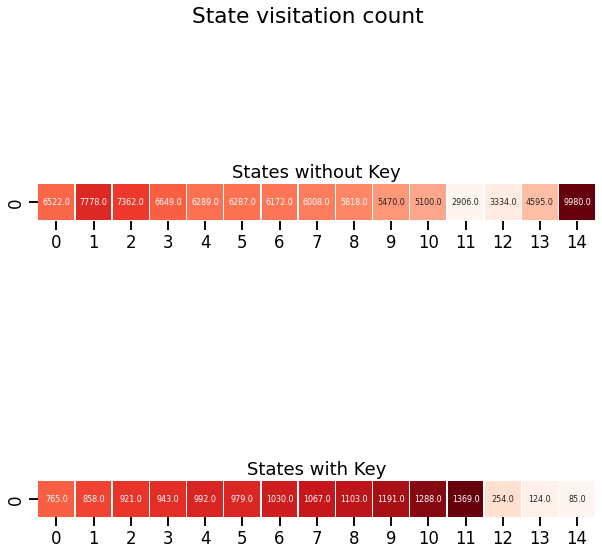

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | *

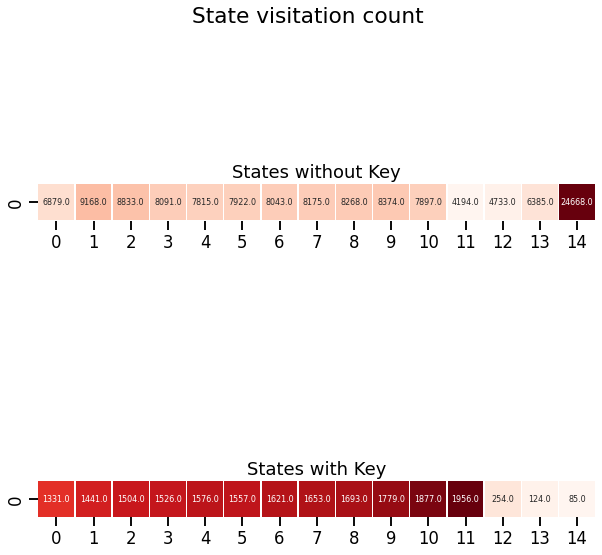

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | *

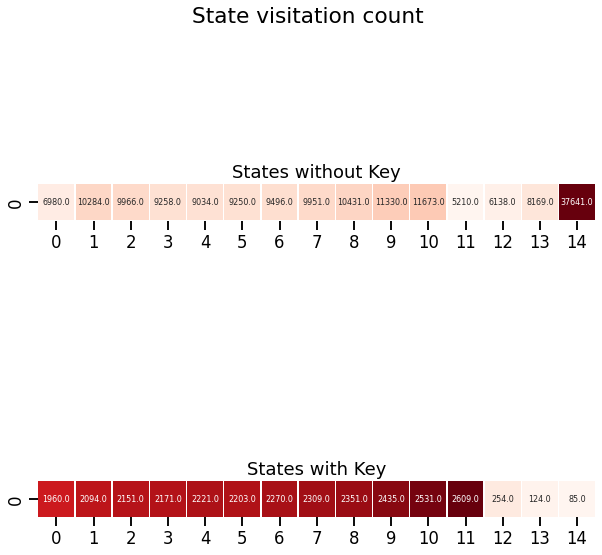

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | *

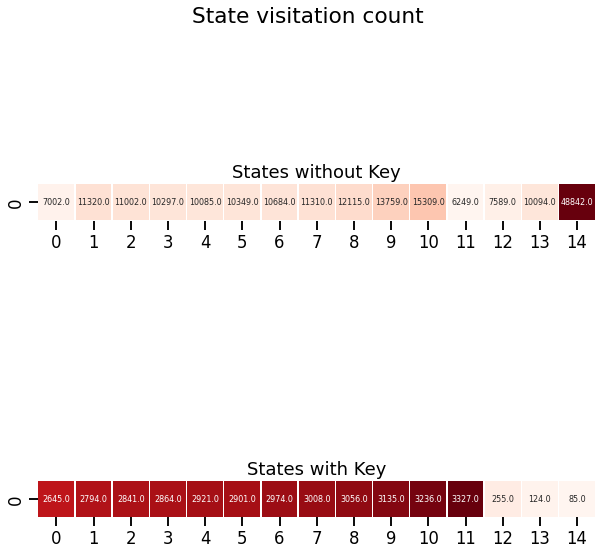

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | *

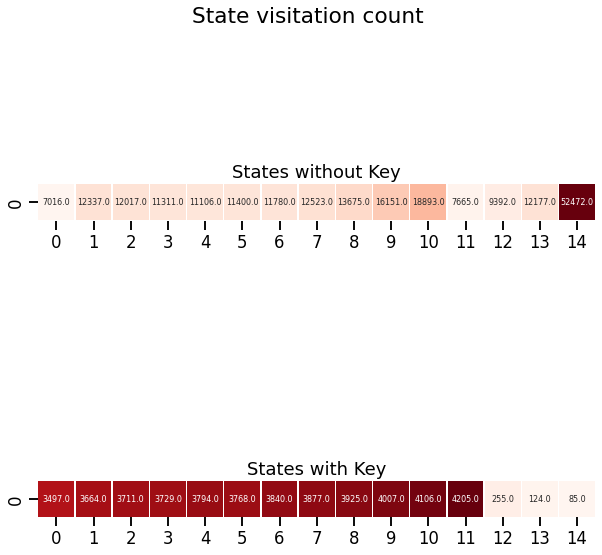

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | * | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | * | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | * | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | * | * | *

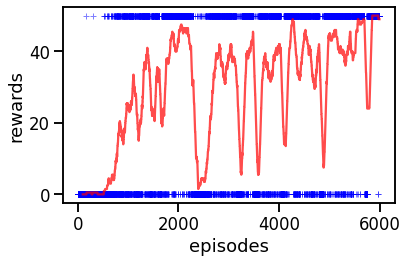

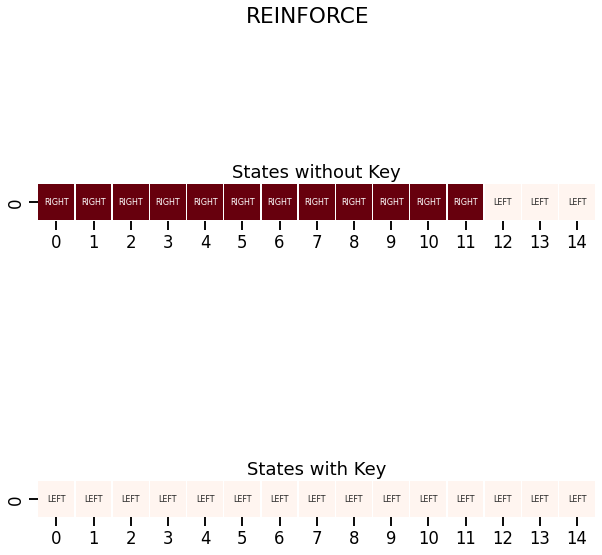

{(0, 0): array([6.5677572e-04, 4.3214457e-03, 9.9502182e-01], dtype=float32),
 (0, 1): array([0.98520386, 0.006333  , 0.00846318], dtype=float32),
 (1, 0): array([7.6103967e-04, 4.8980177e-03, 9.9434090e-01], dtype=float32),
 (1, 1): array([0.99030745, 0.00497827, 0.00471437], dtype=float32),
 (2, 0): array([9.0449804e-04, 5.6158081e-03, 9.9347973e-01], dtype=float32),
 (2, 1): array([0.9933401 , 0.00396803, 0.00269198], dtype=float32),
 (3, 0): array([0.00108969, 0.00647242, 0.9924379 ], dtype=float32),
 (3, 1): array([0.99532664, 0.00317613, 0.00149727], dtype=float32),
 (4, 0): array([0.00133986, 0.00751802, 0.99114215], dtype=float32),
 (4, 1): array([9.9657720e-01, 2.5778762e-03, 8.4494840e-04], dtype=float32),
 (5, 0): array([0.00171666, 0.00888047, 0.9894029 ], dtype=float32),
 (5, 1): array([9.9746048e-01, 2.0773562e-03, 4.6221880e-04], dtype=float32),
 (6, 0): array([0.00241947, 0.01104925, 0.9865313 ], dtype=float32),
 (6, 1): array([9.9810261e-01, 1.6552310e-03, 2.4224592e-0

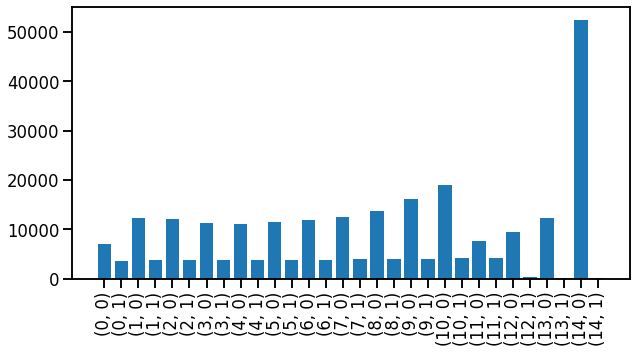

In [15]:
agent_state=train(env,ReinforceCountState,L,logs)
plot_scores(agent_state.scores)
agent_state.get_policy()
plot_policy(env, agent_state.pi, "REINFORCE")
plot_state_freq(agent_state.state_freq)
agent_state.get_proba()

episode:  0


/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:175: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  "Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:191: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting.
  "Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:196: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `options` to allow the en

| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | *

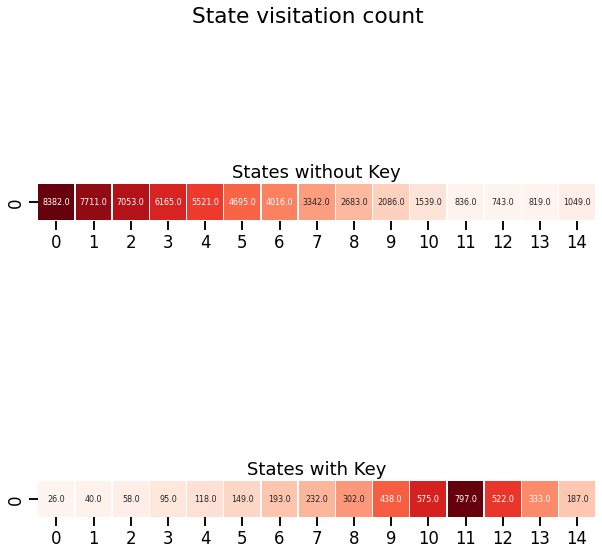

| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| A | * | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | *

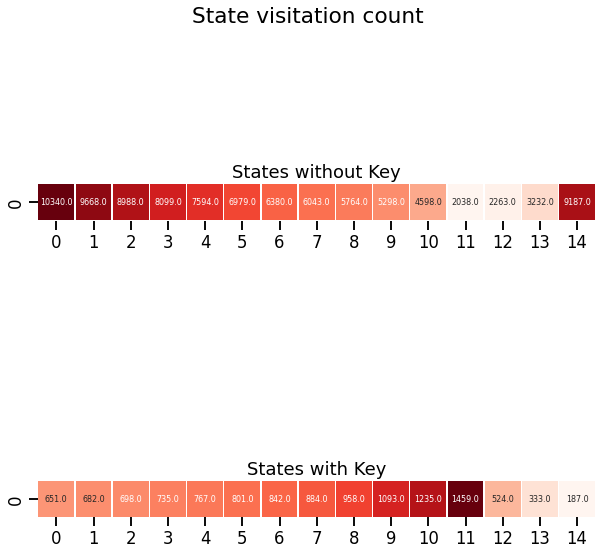

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | *

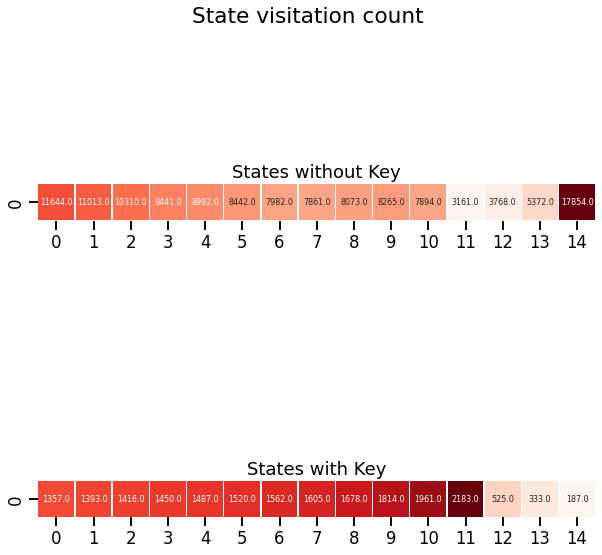

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | * | * | *

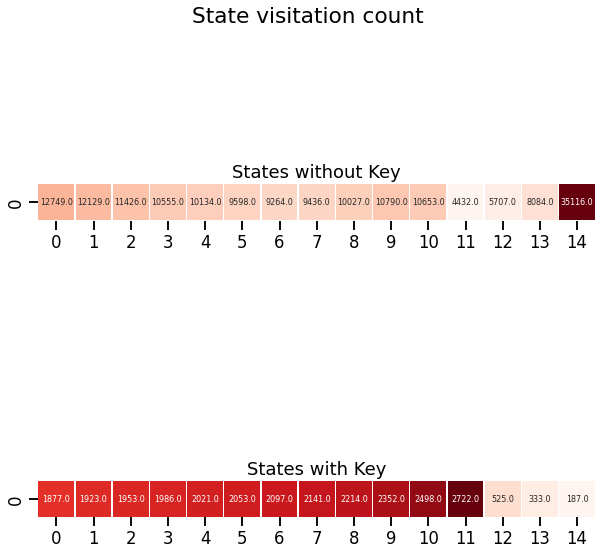

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | * | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | * | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | * | * | *

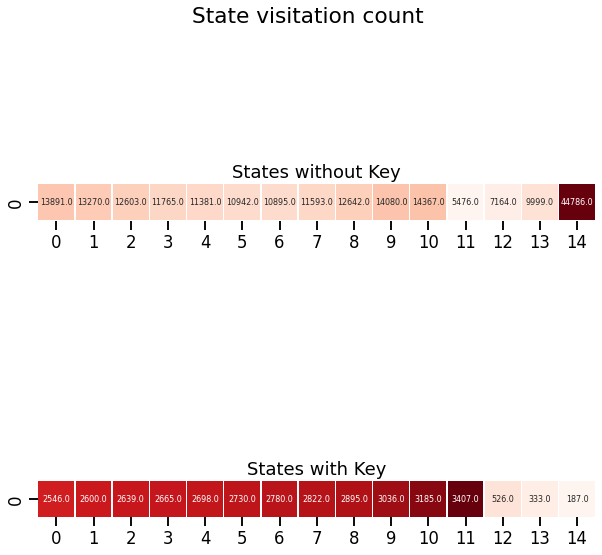

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | *

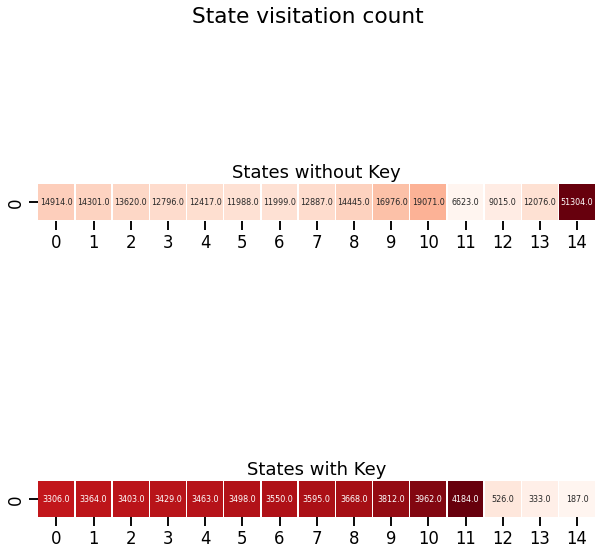

| * | A | * | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | A | * | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | A | * | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | A | * | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | A | * | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | A | * | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | K | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | * | A | * | * | * | 
| * | * | * | * | * | * | * | * | * | * | A | * | * | * | * | 
| * | * | * | * | * | * | * | * | * | A | * | * | * | * | * | 
| * | * | * | * | * | * | * | * | A | * | * | * | * | * | * | 
| * | * | * | * | * | * | * | A | * | * | * | * | * | *

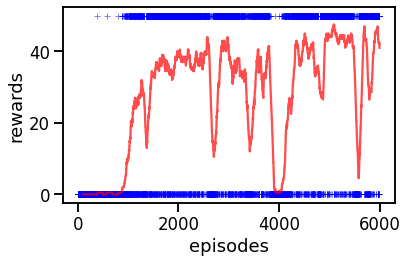

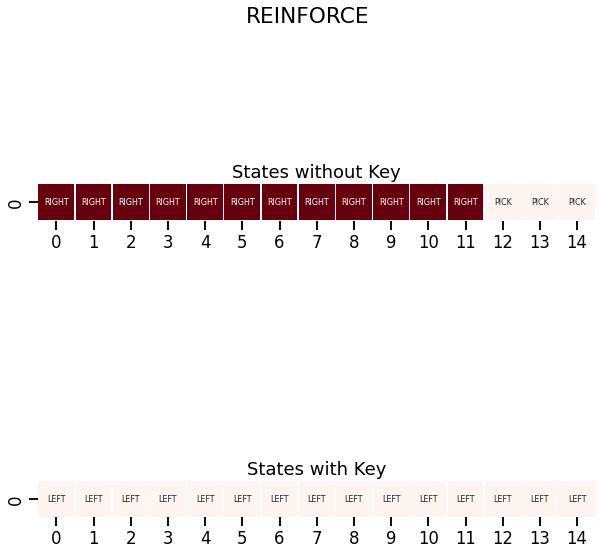

{(0, 0): 14915,
 (0, 1): 3307,
 (1, 0): 14302,
 (1, 1): 3365,
 (2, 0): 13621,
 (2, 1): 3404,
 (3, 0): 12797,
 (3, 1): 3430,
 (4, 0): 12418,
 (4, 1): 3464,
 (5, 0): 11989,
 (5, 1): 3499,
 (6, 0): 12000,
 (6, 1): 3551,
 (7, 0): 12888,
 (7, 1): 3596,
 (8, 0): 14446,
 (8, 1): 3669,
 (9, 0): 16977,
 (9, 1): 3813,
 (10, 0): 19072,
 (10, 1): 3963,
 (11, 0): 6624,
 (11, 1): 4185,
 (12, 0): 9015,
 (12, 1): 526,
 (13, 0): 12076,
 (13, 1): 333,
 (14, 0): 51304,
 (14, 1): 187}

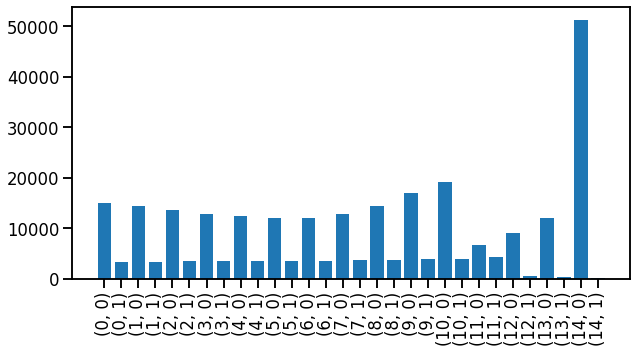

In [11]:
#after counting the first state
agent_state=train(env,ReinforceCountState,L,logs)
plot_scores(agent_state.scores)
agent_state.get_policy()
plot_policy(env, agent_state.pi, "REINFORCE")
plot_state_freq(agent_state.state_freq)
agent_state.get_proba()
agent_state.state_freq

In [ ]:
#before counting the first state
agent_state=train(env,ReinforceCountState,L,logs)
plot_scores(agent_state.scores)
agent_state.get_policy()
plot_policy(env, agent_state.pi, "REINFORCE")
plot_state_freq(agent_state.state_freq)
agent_state.get_proba()
agent_state.state_freq

In [14]:
agent_state.state_freq

{(0, 0): 121329,
 (0, 1): 199,
 (1, 0): 22223,
 (1, 1): 246,
 (2, 0): 20050,
 (2, 1): 287,
 (3, 0): 19099,
 (3, 1): 351,
 (4, 0): 18712,
 (4, 1): 414,
 (5, 0): 17542,
 (5, 1): 525,
 (6, 0): 16143,
 (6, 1): 746,
 (7, 0): 14724,
 (7, 1): 1077,
 (8, 0): 13878,
 (8, 1): 1622,
 (9, 0): 12589,
 (9, 1): 2591,
 (10, 0): 9997,
 (10, 1): 4058,
 (11, 0): 6021,
 (11, 1): 6593,
 (12, 0): 6606,
 (12, 1): 5093,
 (13, 0): 8796,
 (13, 1): 4799,
 (14, 0): 14541,
 (14, 1): 5673}

episode:  0


/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:175: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  "Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:191: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting.
  "Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:196: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `options` to allow the en

episode:  1
episode:  2
episode:  3
episode:  4
episode:  5
episode:  6
episode:  7
episode:  8
episode:  9
episode:  10
episode:  11
episode:  12
episode:  13
episode:  14
episode:  15
episode:  16
episode:  17
episode:  18
episode:  19
episode:  20
episode:  21
episode:  22
episode:  23
episode:  24
episode:  25
episode:  26
episode:  27
episode:  28
episode:  29
episode:  30
episode:  31
episode:  32
episode:  33
episode:  34
episode:  35
episode:  36
episode:  37
episode:  38
episode:  39
episode:  40
episode:  41
episode:  42
episode:  43
episode:  44
episode:  45
episode:  46
episode:  47
episode:  48
episode:  49
episode:  50
episode:  51
episode:  52
episode:  53
episode:  54
episode:  55
episode:  56
episode:  57
episode:  58
episode:  59
episode:  60
episode:  61
episode:  62
episode:  63
episode:  64
episode:  65
episode:  66
episode:  67
episode:  68
episode:  69
episode:  70
episode:  71
episode:  72
episode:  73
episode:  74
episode:  75
episode:  76
episode:  77
episode:

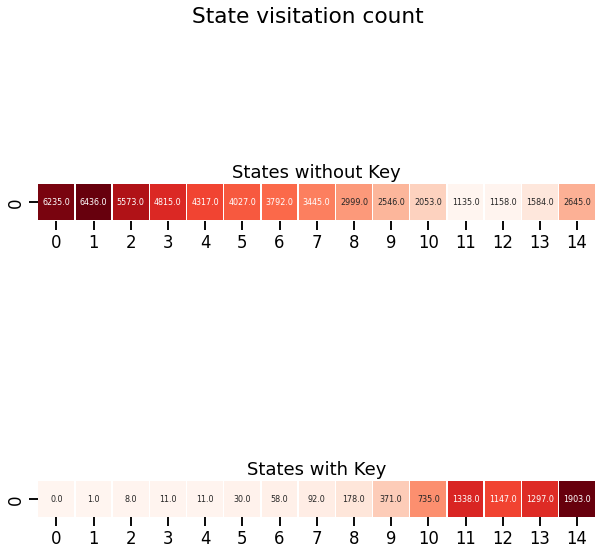

episode:  1000
episode:  1001
episode:  1002
episode:  1003
episode:  1004
episode:  1005
episode:  1006
episode:  1007
episode:  1008
episode:  1009
episode:  1010
episode:  1011
episode:  1012
episode:  1013
episode:  1014
episode:  1015
episode:  1016
episode:  1017
episode:  1018
episode:  1019
episode:  1020
episode:  1021
episode:  1022
episode:  1023
episode:  1024
episode:  1025
episode:  1026
episode:  1027
episode:  1028
episode:  1029
episode:  1030
episode:  1031
episode:  1032
episode:  1033
episode:  1034
episode:  1035
episode:  1036
episode:  1037
episode:  1038
episode:  1039
episode:  1040
episode:  1041
episode:  1042
episode:  1043
episode:  1044
episode:  1045
episode:  1046
episode:  1047
episode:  1048
episode:  1049
episode:  1050
episode:  1051
episode:  1052
episode:  1053
episode:  1054
episode:  1055
episode:  1056
episode:  1057
episode:  1058
episode:  1059
episode:  1060
episode:  1061
episode:  1062
episode:  1063
episode:  1064
episode:  1065
episode:  

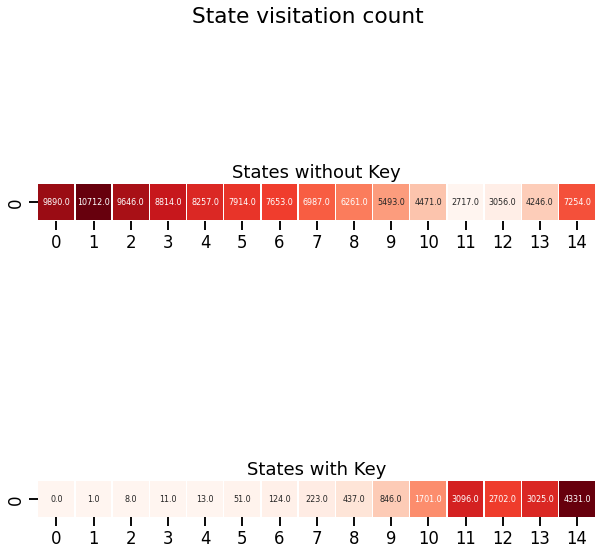

episode:  2000
episode:  2001
episode:  2002
episode:  2003
episode:  2004
episode:  2005
episode:  2006
episode:  2007
episode:  2008
episode:  2009
episode:  2010
episode:  2011
episode:  2012
episode:  2013
episode:  2014
episode:  2015
episode:  2016
episode:  2017
episode:  2018
episode:  2019
episode:  2020
episode:  2021
episode:  2022
episode:  2023
episode:  2024
episode:  2025
episode:  2026
episode:  2027
episode:  2028
episode:  2029
episode:  2030
episode:  2031
episode:  2032
episode:  2033
episode:  2034
episode:  2035
episode:  2036
episode:  2037
episode:  2038
episode:  2039
episode:  2040
episode:  2041
episode:  2042
episode:  2043
episode:  2044
episode:  2045
episode:  2046
episode:  2047
episode:  2048
episode:  2049
episode:  2050
episode:  2051
episode:  2052
episode:  2053
episode:  2054
episode:  2055
episode:  2056
episode:  2057
episode:  2058
episode:  2059
episode:  2060
episode:  2061
episode:  2062
episode:  2063
episode:  2064
episode:  2065
episode:  

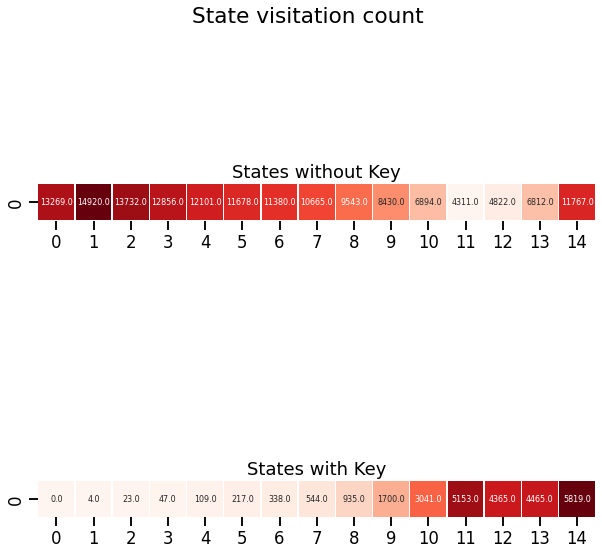

episode:  3000
episode:  3001
episode:  3002
episode:  3003
episode:  3004
episode:  3005
episode:  3006
episode:  3007
episode:  3008
episode:  3009
episode:  3010
episode:  3011
episode:  3012
episode:  3013
episode:  3014
episode:  3015
episode:  3016
episode:  3017
episode:  3018
episode:  3019
episode:  3020
episode:  3021
episode:  3022
episode:  3023
episode:  3024
episode:  3025
episode:  3026
episode:  3027
episode:  3028
episode:  3029
episode:  3030
episode:  3031
episode:  3032
episode:  3033
episode:  3034
episode:  3035
episode:  3036
episode:  3037
episode:  3038
episode:  3039
episode:  3040
episode:  3041
episode:  3042
episode:  3043
episode:  3044
episode:  3045
episode:  3046
episode:  3047
episode:  3048
episode:  3049
episode:  3050
episode:  3051
episode:  3052
episode:  3053
episode:  3054
episode:  3055
episode:  3056
episode:  3057
episode:  3058
episode:  3059
episode:  3060
episode:  3061
episode:  3062
episode:  3063
episode:  3064
episode:  3065
episode:  

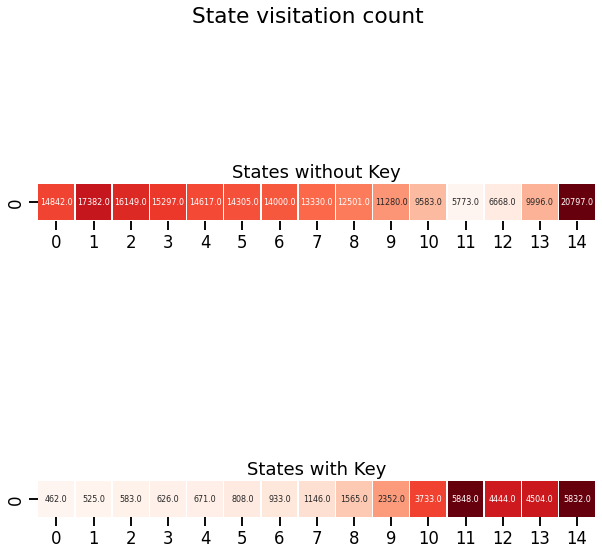

episode:  4000
episode:  4001
episode:  4002
episode:  4003
episode:  4004
episode:  4005
episode:  4006
episode:  4007
episode:  4008
episode:  4009
episode:  4010
episode:  4011
episode:  4012
episode:  4013
episode:  4014
episode:  4015
episode:  4016
episode:  4017
episode:  4018
episode:  4019
episode:  4020
episode:  4021
episode:  4022
episode:  4023
episode:  4024
episode:  4025
episode:  4026
episode:  4027
episode:  4028
episode:  4029
episode:  4030
episode:  4031
episode:  4032
episode:  4033
episode:  4034
episode:  4035
episode:  4036
episode:  4037
episode:  4038
episode:  4039
episode:  4040
episode:  4041
episode:  4042
episode:  4043
episode:  4044
episode:  4045
episode:  4046
episode:  4047
episode:  4048
episode:  4049
episode:  4050
episode:  4051
episode:  4052
episode:  4053
episode:  4054
episode:  4055
episode:  4056
episode:  4057
episode:  4058
episode:  4059
episode:  4060
episode:  4061
episode:  4062
episode:  4063
episode:  4064
episode:  4065
episode:  

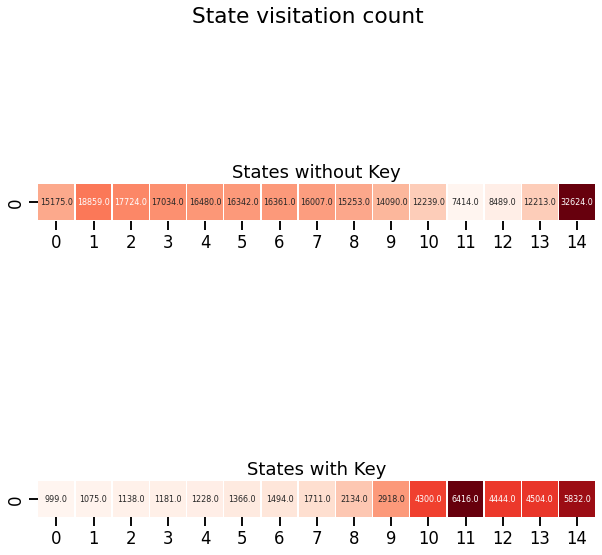

episode:  5000
episode:  5001
episode:  5002
episode:  5003
episode:  5004
episode:  5005
episode:  5006
episode:  5007
episode:  5008
episode:  5009
episode:  5010
episode:  5011
episode:  5012
episode:  5013
episode:  5014
episode:  5015
episode:  5016
episode:  5017
episode:  5018
episode:  5019
episode:  5020
episode:  5021
episode:  5022
episode:  5023
episode:  5024
episode:  5025
episode:  5026
episode:  5027
episode:  5028
episode:  5029
episode:  5030
episode:  5031
episode:  5032
episode:  5033
episode:  5034
episode:  5035
episode:  5036
episode:  5037
episode:  5038
episode:  5039
episode:  5040
episode:  5041
episode:  5042
episode:  5043
episode:  5044
episode:  5045
episode:  5046
episode:  5047
episode:  5048
episode:  5049
episode:  5050
episode:  5051
episode:  5052
episode:  5053
episode:  5054
episode:  5055
episode:  5056
episode:  5057
episode:  5058
episode:  5059
episode:  5060
episode:  5061
episode:  5062
episode:  5063
episode:  5064
episode:  5065
episode:  

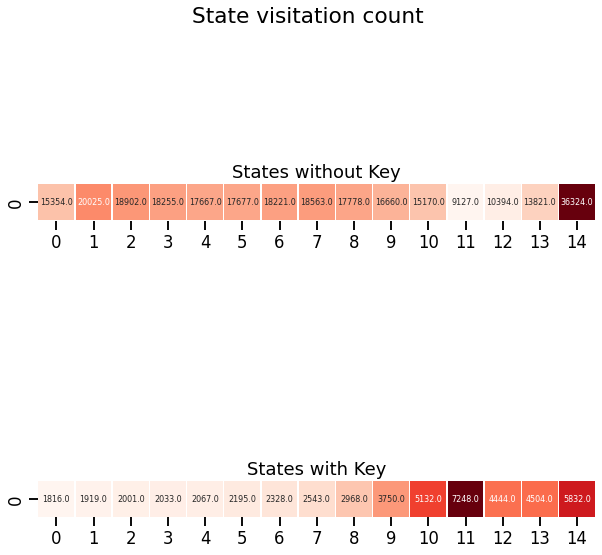

In [11]:
agent_state2=train(env,ReinforceCountStateAction,6000,True,0.9)


In [12]:
agent_state2.state_action_freq

defaultdict(int,
            {((0, 0), -1): 4804,
             ((0, 0), 1): 10467,
             ((1, 0), 1): 9904,
             ((2, 0), 0): 5280,
             ((2, 0), 1): 9601,
             ((3, 0), 0): 5108,
             ((3, 0), -1): 3719,
             ((2, 0), -1): 3968,
             ((3, 0), 1): 9363,
             ((4, 0), 0): 4933,
             ((4, 0), 1): 9117,
             ((5, 0), 0): 5004,
             ((5, 0), -1): 3372,
             ((4, 0), -1): 3547,
             ((5, 0), 1): 9214,
             ((6, 0), 1): 9320,
             ((7, 0), -1): 3790,
             ((6, 0), -1): 3558,
             ((6, 0), 0): 5224,
             ((1, 0), -1): 4501,
             ((7, 0), 0): 5550,
             ((7, 0), 1): 9096,
             ((8, 0), 1): 8406,
             ((9, 0), -1): 3157,
             ((8, 0), 0): 5546,
             ((9, 0), 1): 7848,
             ((10, 0), 0): 5476,
             ((10, 0), -1): 2749,
             ((9, 0), 0): 5513,
             ((8, 0), -1): 3711,
         


****************************************************************************************************
TRAINING START


Iteration:  0
(0, 0) probas:  [0.33 0.33 0.33]
(0, 1) probas:  [0.34 0.32 0.34]
(1, 0) probas:  [0.33 0.33 0.34]
(1, 1) probas:  [0.33 0.32 0.34]
(2, 0) probas:  [0.33 0.33 0.34]
(2, 1) probas:  [0.33 0.32 0.35]
(3, 0) probas:  [0.33 0.32 0.34]
(3, 1) probas:  [0.33 0.32 0.35]
(4, 0) probas:  [0.33 0.32 0.35]
(4, 1) probas:  [0.33 0.32 0.35]
Score: 0
% of visited states: 20.0%

Iteration:  1
Score: 50
% of visited states: 40.0%

Iteration:  2
Score: 0
% of visited states: 40.0%

Iteration:  3
Score: 0
% of visited states: 40.0%

Iteration:  4
Score: 0
% of visited states: 70.0%

Iteration:  5
Score: 0
% of visited states: 80.0%

Iteration:  6
Score: 0
% of visited states: 80.0%

Iteration:  7
Score: 0
% of visited states: 80.0%

Iteration:  8
Score: 0
% of visited states: 80.0%

Iteration:  9
Score: 50
% of visited states: 100.0%

Iteration:  10
Score: 0
% of visited s

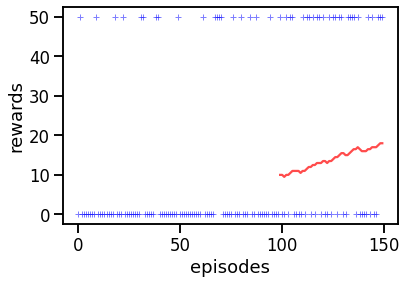

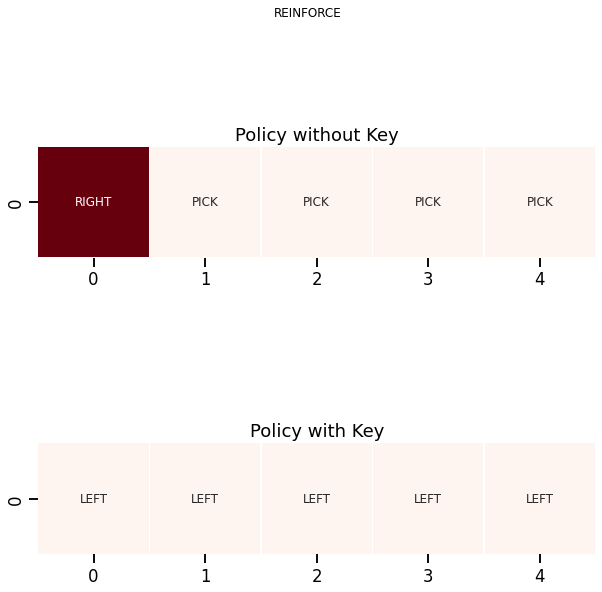

{(0, 0): array([0.18317495, 0.38030526, 0.43651974], dtype=float32),
 (0, 1): array([0.7146617 , 0.17692883, 0.10840943], dtype=float32),
 (1, 0): array([0.17018975, 0.4221538 , 0.40765643], dtype=float32),
 (1, 1): array([0.73973864, 0.17181796, 0.08844343], dtype=float32),
 (2, 0): array([0.17140451, 0.47702572, 0.3515698 ], dtype=float32),
 (2, 1): array([0.7476086 , 0.1772691 , 0.07512228], dtype=float32),
 (3, 0): array([0.17678806, 0.528434  , 0.294778  ], dtype=float32),
 (3, 1): array([0.7431577 , 0.1912101 , 0.06563218], dtype=float32),
 (4, 0): array([0.18215184, 0.57352483, 0.24432333], dtype=float32),
 (4, 1): array([0.73322135, 0.20956437, 0.05721426], dtype=float32)}

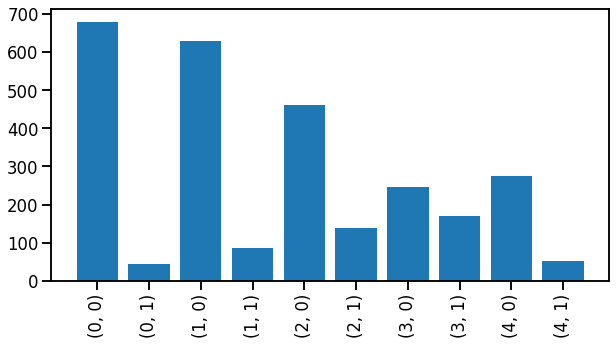

In [30]:
agent_seq=train(env,ReinforceCountSeq,L,logs)
plot_scores(agent_seq.scores)
agent_seq.get_policy()
plot_policy(env, agent_seq.pi, "REINFORCE")
plot_state_freq(agent_seq.state_freq)
agent_seq.get_proba()

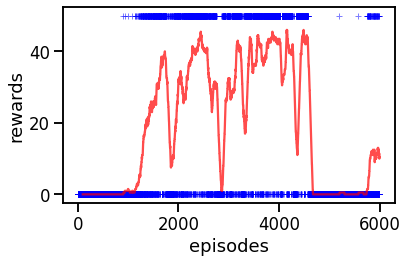

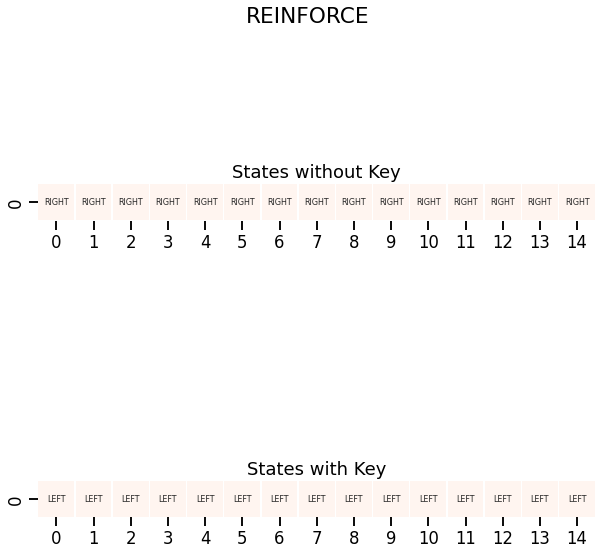

{(0, 0): array([0.00417256, 0.21086596, 0.7849614 ], dtype=float32),
 (0, 1): array([0.99607486, 0.00229359, 0.00163149], dtype=float32),
 (1, 0): array([0.00412949, 0.21583766, 0.7800329 ], dtype=float32),
 (1, 1): array([0.9972077 , 0.0017142 , 0.00107813], dtype=float32),
 (2, 0): array([0.00408083, 0.22089678, 0.7750224 ], dtype=float32),
 (2, 1): array([9.9795926e-01, 1.3102954e-03, 7.3041744e-04], dtype=float32),
 (3, 0): array([0.00403761, 0.22635669, 0.7696057 ], dtype=float32),
 (3, 1): array([9.9847573e-01, 1.0197085e-03, 5.0461449e-04], dtype=float32),
 (4, 0): array([0.00399373, 0.23257989, 0.76342636], dtype=float32),
 (4, 1): array([9.988656e-01, 7.899036e-04, 3.444612e-04], dtype=float32),
 (5, 0): array([0.00397387, 0.24105407, 0.7549721 ], dtype=float32),
 (5, 1): array([9.9913788e-01, 6.2351493e-04, 2.3859671e-04], dtype=float32),
 (6, 0): array([0.00407864, 0.25493282, 0.7409885 ], dtype=float32),
 (6, 1): array([9.993364e-01, 4.959670e-04, 1.676073e-04], dtype=float

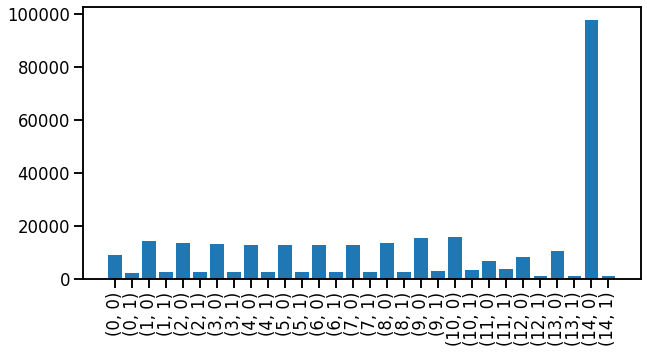

In [19]:
plot_scores(agent_state2.scores)
agent_state2.get_policy()
plot_policy(env, agent_state2.pi, "REINFORCE")
plot_state_freq(agent_state2.state_freq)
agent_state2.get_proba()

episode:  0
episode:  1
episode:  2
episode:  3
episode:  4
episode:  5
episode:  6
episode:  7
episode:  8
episode:  9
episode:  10
episode:  11
episode:  12
episode:  13
episode:  14
episode:  15
episode:  16
episode:  17
episode:  18
episode:  19
episode:  20
episode:  21
episode:  22
episode:  23
episode:  24
episode:  25
episode:  26
episode:  27
episode:  28
episode:  29
episode:  30
episode:  31
episode:  32
episode:  33
episode:  34
episode:  35
episode:  36
episode:  37
episode:  38
episode:  39
episode:  40
episode:  41
episode:  42
episode:  43
episode:  44
episode:  45
episode:  46
episode:  47
episode:  48
episode:  49
episode:  50
episode:  51
episode:  52
episode:  53
episode:  54
episode:  55
episode:  56
episode:  57
episode:  58
episode:  59
episode:  60
episode:  61
episode:  62
episode:  63
episode:  64
episode:  65
episode:  66
episode:  67
episode:  68
episode:  69
episode:  70
episode:  71
episode:  72
episode:  73
episode:  74
episode:  75
episode:  76
episode: 

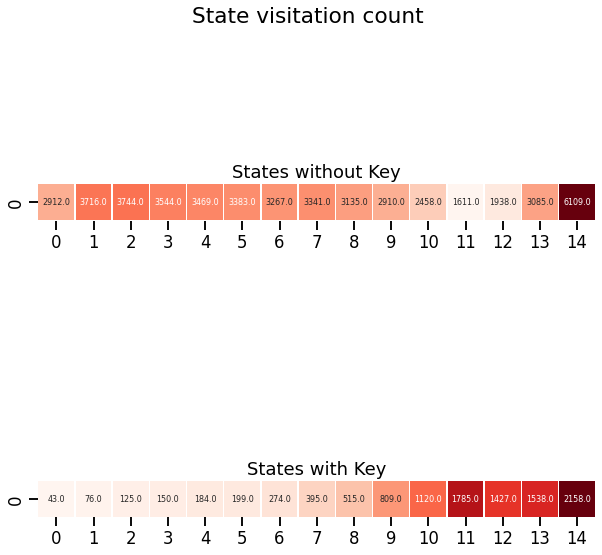

episode:  1000
episode:  1001
episode:  1002
episode:  1003
episode:  1004
episode:  1005
episode:  1006
episode:  1007
episode:  1008
episode:  1009
episode:  1010
episode:  1011
episode:  1012
episode:  1013
episode:  1014
episode:  1015
episode:  1016
episode:  1017
episode:  1018
episode:  1019
episode:  1020
episode:  1021
episode:  1022
episode:  1023
episode:  1024
episode:  1025
episode:  1026
episode:  1027
episode:  1028
episode:  1029
episode:  1030
episode:  1031
episode:  1032
episode:  1033
episode:  1034
episode:  1035
episode:  1036
episode:  1037
episode:  1038
episode:  1039
episode:  1040
episode:  1041
episode:  1042
episode:  1043
episode:  1044
episode:  1045
episode:  1046
episode:  1047
episode:  1048
episode:  1049
episode:  1050
episode:  1051
episode:  1052
episode:  1053
episode:  1054
episode:  1055
episode:  1056
episode:  1057
episode:  1058
episode:  1059
episode:  1060
episode:  1061
episode:  1062
episode:  1063
episode:  1064
episode:  1065
episode:  

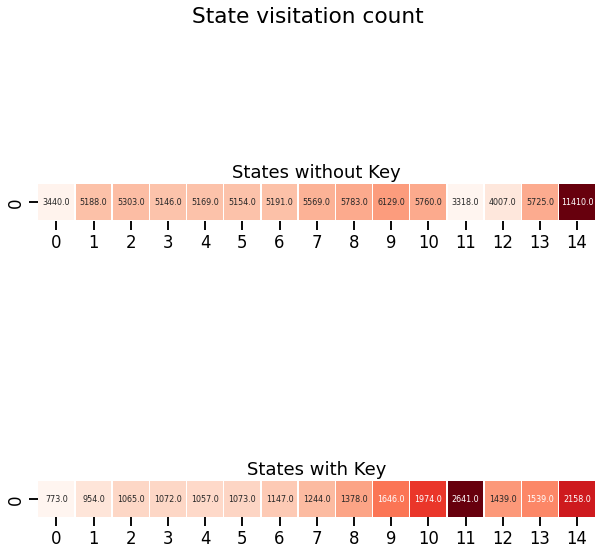

episode:  2000
episode:  2001
episode:  2002
episode:  2003
episode:  2004
episode:  2005
episode:  2006
episode:  2007
episode:  2008
episode:  2009
episode:  2010
episode:  2011
episode:  2012
episode:  2013
episode:  2014
episode:  2015
episode:  2016
episode:  2017
episode:  2018
episode:  2019
episode:  2020
episode:  2021
episode:  2022
episode:  2023
episode:  2024
episode:  2025
episode:  2026
episode:  2027
episode:  2028
episode:  2029
episode:  2030
episode:  2031
episode:  2032
episode:  2033
episode:  2034
episode:  2035
episode:  2036
episode:  2037
episode:  2038
episode:  2039
episode:  2040
episode:  2041
episode:  2042
episode:  2043
episode:  2044
episode:  2045
episode:  2046
episode:  2047
episode:  2048
episode:  2049
episode:  2050
episode:  2051
episode:  2052
episode:  2053
episode:  2054
episode:  2055
episode:  2056
episode:  2057
episode:  2058
episode:  2059
episode:  2060
episode:  2061
episode:  2062
episode:  2063
episode:  2064
episode:  2065
episode:  

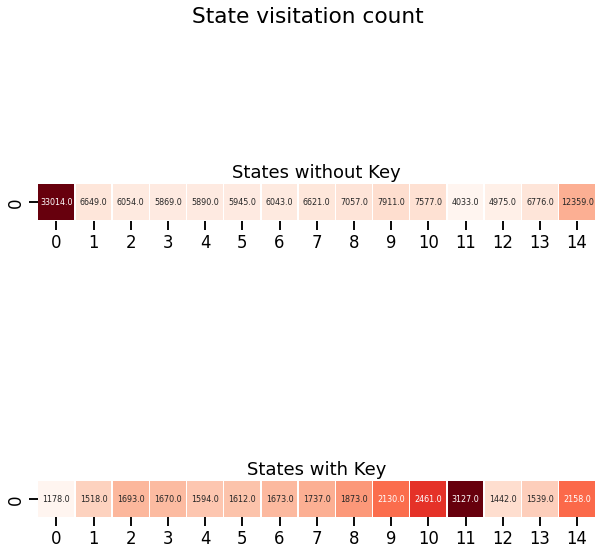

episode:  3000
episode:  3001
episode:  3002
episode:  3003
episode:  3004
episode:  3005
episode:  3006
episode:  3007
episode:  3008
episode:  3009
episode:  3010
episode:  3011
episode:  3012
episode:  3013
episode:  3014
episode:  3015
episode:  3016
episode:  3017
episode:  3018
episode:  3019
episode:  3020
episode:  3021
episode:  3022
episode:  3023
episode:  3024
episode:  3025
episode:  3026
episode:  3027
episode:  3028
episode:  3029
episode:  3030
episode:  3031
episode:  3032
episode:  3033
episode:  3034
episode:  3035
episode:  3036
episode:  3037
episode:  3038
episode:  3039
episode:  3040
episode:  3041
episode:  3042
episode:  3043
episode:  3044
episode:  3045
episode:  3046
episode:  3047
episode:  3048
episode:  3049
episode:  3050
episode:  3051
episode:  3052
episode:  3053
episode:  3054
episode:  3055
episode:  3056
episode:  3057
episode:  3058
episode:  3059
episode:  3060
episode:  3061
episode:  3062
episode:  3063
episode:  3064
episode:  3065
episode:  

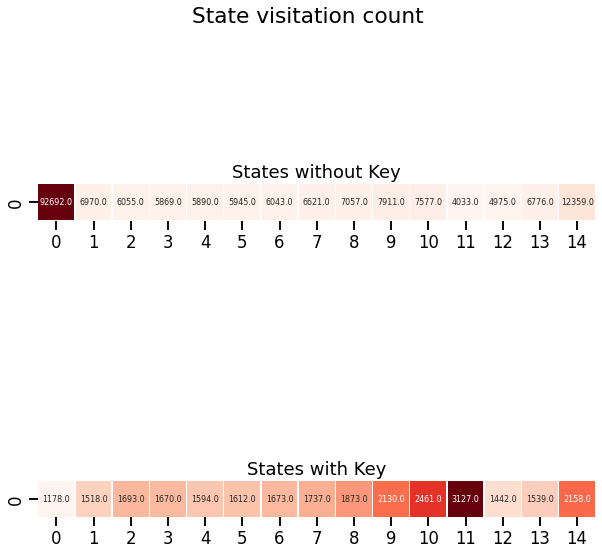

episode:  4000
episode:  4001
episode:  4002
episode:  4003
episode:  4004
episode:  4005
episode:  4006
episode:  4007
episode:  4008
episode:  4009
episode:  4010
episode:  4011
episode:  4012
episode:  4013
episode:  4014
episode:  4015
episode:  4016
episode:  4017
episode:  4018
episode:  4019
episode:  4020
episode:  4021
episode:  4022
episode:  4023
episode:  4024
episode:  4025
episode:  4026
episode:  4027
episode:  4028
episode:  4029
episode:  4030
episode:  4031
episode:  4032
episode:  4033
episode:  4034
episode:  4035
episode:  4036
episode:  4037
episode:  4038
episode:  4039
episode:  4040
episode:  4041
episode:  4042
episode:  4043
episode:  4044
episode:  4045
episode:  4046
episode:  4047
episode:  4048
episode:  4049
episode:  4050
episode:  4051
episode:  4052
episode:  4053
episode:  4054
episode:  4055
episode:  4056
episode:  4057
episode:  4058
episode:  4059
episode:  4060
episode:  4061
episode:  4062
episode:  4063
episode:  4064
episode:  4065
episode:  

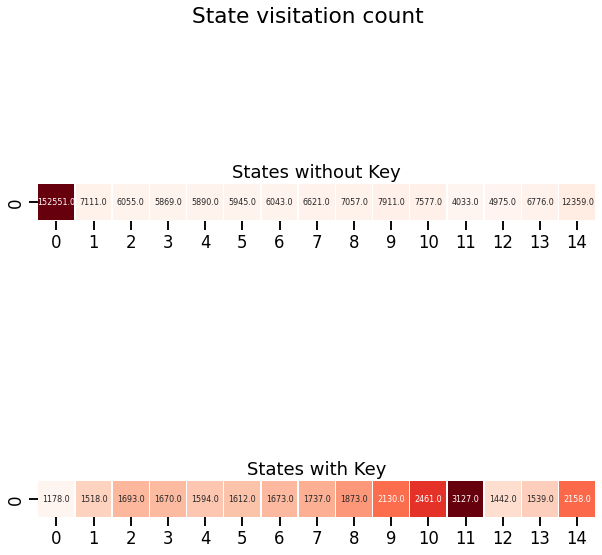

episode:  5000
episode:  5001
episode:  5002
episode:  5003
episode:  5004
episode:  5005
episode:  5006
episode:  5007
episode:  5008
episode:  5009
episode:  5010
episode:  5011
episode:  5012
episode:  5013
episode:  5014
episode:  5015
episode:  5016
episode:  5017
episode:  5018
episode:  5019
episode:  5020
episode:  5021
episode:  5022
episode:  5023
episode:  5024
episode:  5025
episode:  5026
episode:  5027
episode:  5028
episode:  5029
episode:  5030
episode:  5031
episode:  5032
episode:  5033
episode:  5034
episode:  5035
episode:  5036
episode:  5037
episode:  5038
episode:  5039
episode:  5040
episode:  5041
episode:  5042
episode:  5043
episode:  5044
episode:  5045
episode:  5046
episode:  5047
episode:  5048
episode:  5049
episode:  5050
episode:  5051
episode:  5052
episode:  5053
episode:  5054
episode:  5055
episode:  5056
episode:  5057
episode:  5058
episode:  5059
episode:  5060
episode:  5061
episode:  5062
episode:  5063
episode:  5064
episode:  5065
episode:  

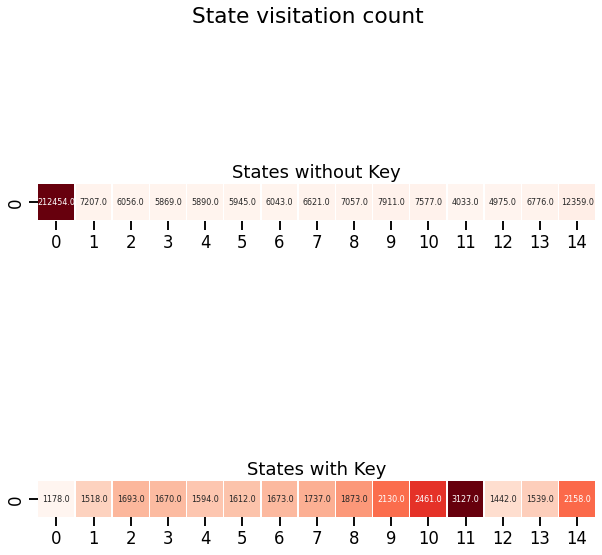

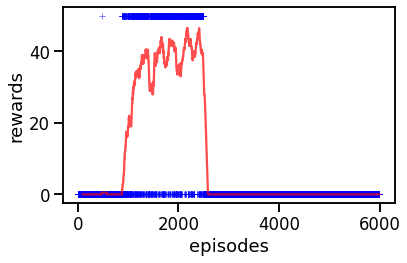

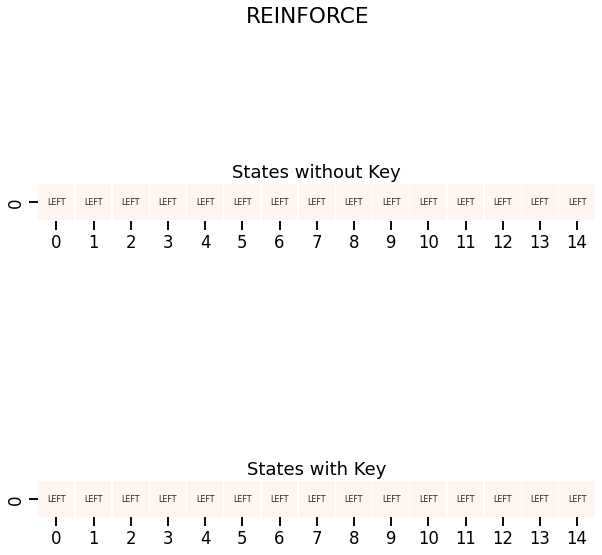

{(0, 0): array([0.9892837 , 0.00909347, 0.00162286], dtype=float32),
 (0, 1): array([9.9996293e-01, 3.6985221e-05, 1.2713693e-07], dtype=float32),
 (1, 0): array([0.9912743 , 0.00760595, 0.00111975], dtype=float32),
 (1, 1): array([9.9997175e-01, 2.8177292e-05, 6.9352090e-08], dtype=float32),
 (2, 0): array([9.9329823e-01, 6.0310843e-03, 6.7071029e-04], dtype=float32),
 (2, 1): array([9.9997902e-01, 2.0995289e-05, 3.5810345e-08], dtype=float32),
 (3, 0): array([9.9514526e-01, 4.5266198e-03, 3.2810820e-04], dtype=float32),
 (3, 1): array([9.9998462e-01, 1.5360683e-05, 1.7766430e-08], dtype=float32),
 (4, 0): array([9.9648464e-01, 3.3653190e-03, 1.5007988e-04], dtype=float32),
 (4, 1): array([9.9998891e-01, 1.1070170e-05, 8.5820195e-09], dtype=float32),
 (5, 0): array([9.9746215e-01, 2.4700847e-03, 6.7719062e-05], dtype=float32),
 (5, 1): array([9.9999213e-01, 7.9133233e-06, 4.0685899e-09], dtype=float32),
 (6, 0): array([9.9817133e-01, 1.7985082e-03, 3.0106954e-05], dtype=float32),
 (6,

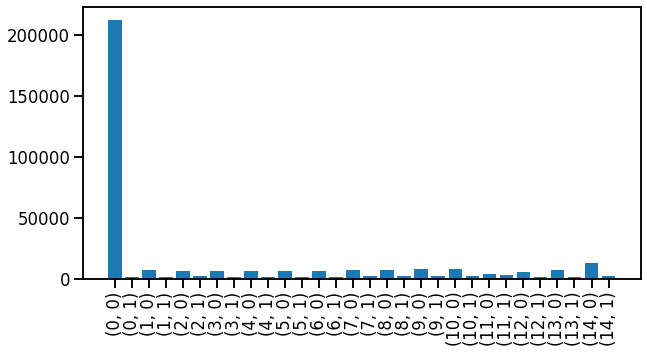

In [18]:
agent_seq_edited=train(env,ReinforceCountSeqEdited,6000,True,0.9)
plot_scores(agent_seq_edited.scores)
agent_seq_edited.get_policy()
plot_policy(env, agent_seq_edited.pi, "REINFORCE")
plot_state_freq(agent_seq_edited.state_freq)
agent_seq_edited.get_proba()

In [31]:
agent= ReinforceBaseline(env)


In [24]:
agent.env

<OrderEnforcing<StepAPICompatibility<PassiveEnvChecker<KeyGridSparse<keygrid-v0>>>>>

In [65]:
agent.train(200)


****************************************************************************************************
TRAINING START


Iteration:  0
(0, 0) probas:  [0.33 0.33 0.33]
(0, 1) probas:  [0.34 0.32 0.34]
(1, 0) probas:  [0.33 0.33 0.34]
(1, 1) probas:  [0.34 0.32 0.34]
(2, 0) probas:  [0.33 0.33 0.35]
(2, 1) probas:  [0.33 0.32 0.34]
(3, 0) probas:  [0.32 0.32 0.35]
(3, 1) probas:  [0.33 0.32 0.34]
(4, 0) probas:  [0.32 0.32 0.36]
(4, 1) probas:  [0.33 0.32 0.35]
Score: 0
% of visited states: 40.0%

Iteration:  1
Score: 0
% of visited states: 50.0%

Iteration:  2
Score: 50
% of visited states: 60.0%

Iteration:  3
Score: 0
% of visited states: 60.0%

Iteration:  4
Score: 0
% of visited states: 60.0%

Iteration:  5
Score: 0
% of visited states: 70.0%

Iteration:  6
Score: 0
% of visited states: 70.0%

Iteration:  7
Score: 0
% of visited states: 70.0%

Iteration:  8
Score: 50
% of visited states: 100.0%

Iteration:  9
Score: 0
% of visited states: 100.0%

Iteration:  10
Score: 0
% of visited 

In [54]:
agent.train(150)


****************************************************************************************************
TRAINING START


Iteration:  0
(0, 0) probas:  [0.33 0.33 0.33]
(0, 1) probas:  [0.33 0.35 0.32]
(1, 0) probas:  [0.33 0.34 0.33]
(1, 1) probas:  [0.32 0.35 0.33]
(2, 0) probas:  [0.33 0.34 0.33]
(2, 1) probas:  [0.32 0.35 0.32]
(3, 0) probas:  [0.32 0.35 0.33]
(3, 1) probas:  [0.32 0.35 0.33]
(4, 0) probas:  [0.32 0.36 0.33]
(4, 1) probas:  [0.31 0.36 0.33]
Score: 0
% of visited states: 20.0%

Iteration:  1
Score: 0
% of visited states: 40.0%

Iteration:  2
Score: 0
% of visited states: 40.0%

Iteration:  3
Score: 0
% of visited states: 70.0%

Iteration:  4
Score: 0
% of visited states: 80.0%

Iteration:  5
Score: 0
% of visited states: 90.0%

Iteration:  6
Score: 0
% of visited states: 90.0%

Iteration:  7
Score: 0
% of visited states: 90.0%

Iteration:  8
Score: 0
% of visited states: 90.0%

Iteration:  9
Score: 0
% of visited states: 90.0%

Iteration:  10
Score: 50
% of visited sta

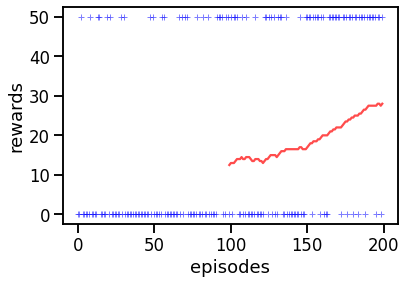

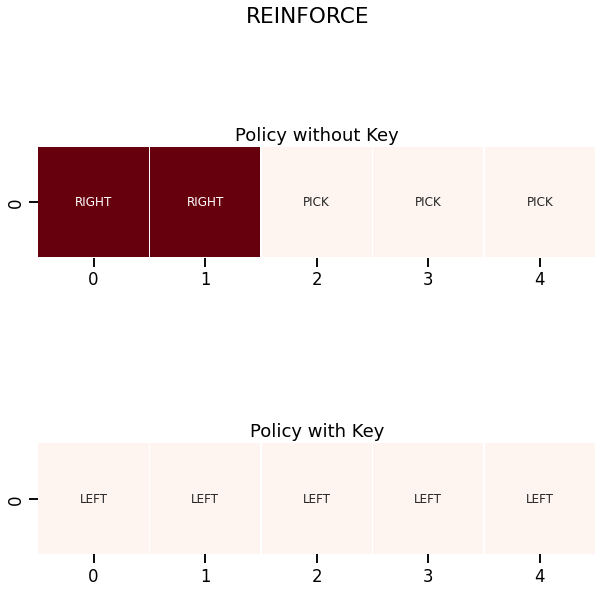

{(0, 0): array([0.1129586, 0.335252 , 0.5517894], dtype=float32),
 (0, 1): array([0.94914263, 0.0399063 , 0.01095109], dtype=float32),
 (1, 0): array([0.11784684, 0.40525514, 0.47689798], dtype=float32),
 (1, 1): array([0.9636613 , 0.03017763, 0.00616108], dtype=float32),
 (2, 0): array([0.15521395, 0.48549277, 0.3592933 ], dtype=float32),
 (2, 1): array([0.9716609 , 0.02463372, 0.00370546], dtype=float32),
 (3, 0): array([0.20674235, 0.5343454 , 0.25891232], dtype=float32),
 (3, 1): array([0.97616506, 0.02147893, 0.00235593], dtype=float32),
 (4, 0): array([0.25990918, 0.5570948 , 0.18299593], dtype=float32),
 (4, 1): array([0.9789039 , 0.01955132, 0.00154476], dtype=float32)}

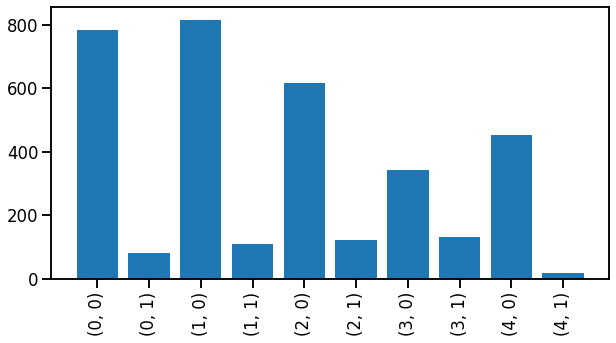

In [66]:
plot_scores(agent.scores)
agent.get_policy()
plot_policy(env, agent.pi, "REINFORCE")
plot_state_freq(agent.state_freq)
agent.get_proba()

### Reinforce count state exploration

In [67]:
from rl_research.algorithms.reinforce_count_states import train

ImportError: cannot import name 'train'

In [74]:
agent_state_count = train(env,ReinforceCountState, 150, logs=logs)


****************************************************************************************************
TRAINING START


Iteration:  0
(0, 0) probas:  [0.33 0.33 0.33]
(0, 1) probas:  [0.33 0.37 0.31]
(1, 0) probas:  [0.33 0.34 0.33]
(1, 1) probas:  [0.32 0.38 0.3 ]
(2, 0) probas:  [0.32 0.35 0.32]
(2, 1) probas:  [0.32 0.38 0.3 ]
(3, 0) probas:  [0.32 0.36 0.32]
(3, 1) probas:  [0.32 0.39 0.29]
(4, 0) probas:  [0.31 0.37 0.31]
(4, 1) probas:  [0.32 0.4  0.29]
Score: 50
% of visited states: 30.0%

Iteration:  1
Score: 0
% of visited states: 60.0%

Iteration:  2
Score: 50
% of visited states: 90.0%

Iteration:  3
Score: 0
% of visited states: 90.0%

Iteration:  4
Score: 0
% of visited states: 90.0%

Iteration:  5
Score: 0
% of visited states: 90.0%

Iteration:  6
Score: 0
% of visited states: 90.0%

Iteration:  7
Score: 0
% of visited states: 90.0%

Iteration:  8
Score: 0
% of visited states: 90.0%

Iteration:  9
Score: 0
% of visited states: 100.0%

Iteration:  10
Score: 0
% of visited s

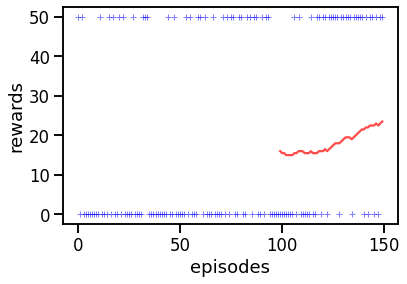

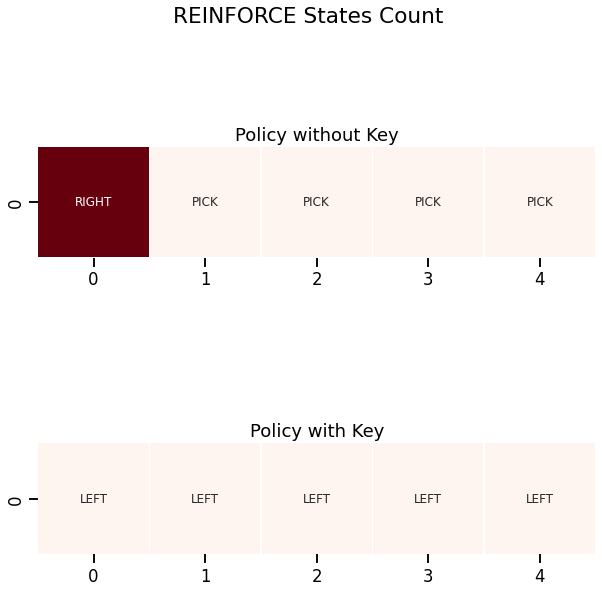

{(0, 0): array([0.04055845, 0.47251385, 0.48692763], dtype=float32),
 (0, 1): array([0.9158276 , 0.04498885, 0.03918352], dtype=float32),
 (1, 0): array([0.0312305 , 0.5759538 , 0.39281568], dtype=float32),
 (1, 1): array([0.92140776, 0.04916171, 0.02943057], dtype=float32),
 (2, 0): array([0.02539306, 0.6905756 , 0.28403142], dtype=float32),
 (2, 1): array([0.9141172 , 0.06187189, 0.02401084], dtype=float32),
 (3, 0): array([0.02164023, 0.7828658 , 0.19549386], dtype=float32),
 (3, 1): array([0.89818966, 0.0816617 , 0.02014865], dtype=float32),
 (4, 0): array([0.01870664, 0.8465596 , 0.13473375], dtype=float32),
 (4, 1): array([0.8753849 , 0.10773738, 0.01687774], dtype=float32)}

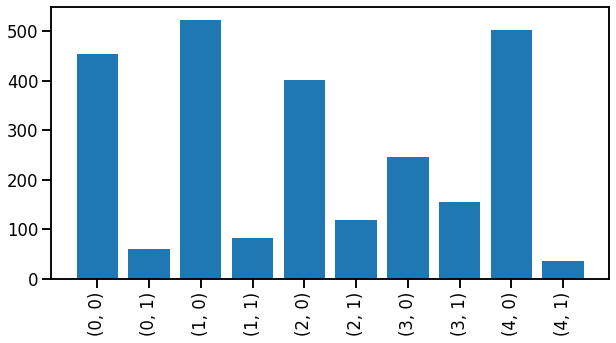

In [75]:
plot_scores(agent_state_count.scores)
agent_state_count.get_policy()
plot_policy(env, agent_state_count.pi, "REINFORCE States Count")
plot_state_freq(agent_state_count.state_freq)
agent_state_count.get_proba()

### Reinforce count seq exploration

In [73]:
from rl_research.algorithms.reinforce_count_seq import train

In [74]:
agent = train(env, L, logs=logs)


****************************************************************************************************
TRAINING START


Iteration:  0
(0, 0) probas:  [0.33 0.33 0.33]
(0, 1) probas:  [0.37 0.3  0.33]
(1, 0) probas:  [0.33 0.34 0.33]
(1, 1) probas:  [0.36 0.31 0.33]
(2, 0) probas:  [0.33 0.34 0.33]
(2, 1) probas:  [0.36 0.31 0.34]
(3, 0) probas:  [0.33 0.34 0.33]
(3, 1) probas:  [0.35 0.31 0.33]
(4, 0) probas:  [0.33 0.34 0.33]
(4, 1) probas:  [0.35 0.31 0.33]
Score: 0
% of visited states: 30.0%

Iteration:  1
Score: 50
% of visited states: 60.0%

Iteration:  2
Score: 0
% of visited states: 60.0%

Iteration:  3
Score: 0
% of visited states: 70.0%

Iteration:  4
Score: 0
% of visited states: 70.0%

Iteration:  5
Score: 50
% of visited states: 80.0%

Iteration:  6
Score: 0
% of visited states: 80.0%

Iteration:  7
Score: 0
% of visited states: 100.0%

Iteration:  8
Score: 0
% of visited states: 100.0%

Iteration:  9
Score: 50
% of visited states: 100.0%

Iteration:  10
(0, 0) probas:  [0.3


Iteration:  96
Score: 0
% of visited states: 100.0%

Iteration:  97
Score: 0
% of visited states: 100.0%

Iteration:  98
Score: 0
% of visited states: 100.0%

Iteration:  99
Score: 50
% of visited states: 100.0%

Iteration:  100
(0, 0) probas:  [0.21 0.31 0.48]
(0, 1) probas:  [0.94 0.02 0.04]
(1, 0) probas:  [0.16 0.44 0.4 ]
(1, 1) probas:  [0.95 0.02 0.03]
(2, 0) probas:  [0.12 0.58 0.3 ]
(2, 1) probas:  [0.95 0.02 0.03]
(3, 0) probas:  [0.1  0.68 0.22]
(3, 1) probas:  [0.95 0.03 0.02]
(4, 0) probas:  [0.09 0.75 0.16]
(4, 1) probas:  [0.93 0.05 0.02]
Score: 50
% of visited states: 100.0%

Iteration:  101
Score: 50
% of visited states: 100.0%

Iteration:  102
Score: 50
% of visited states: 100.0%

Iteration:  103
Score: 0
% of visited states: 100.0%

Iteration:  104
Score: 50
% of visited states: 100.0%

Iteration:  105
Score: 50
% of visited states: 100.0%

Iteration:  106
Score: 50
% of visited states: 100.0%

Iteration:  107
Score: 50
% of visited states: 100.0%

Iteration:  108
S

<Figure size 720x360 with 0 Axes>

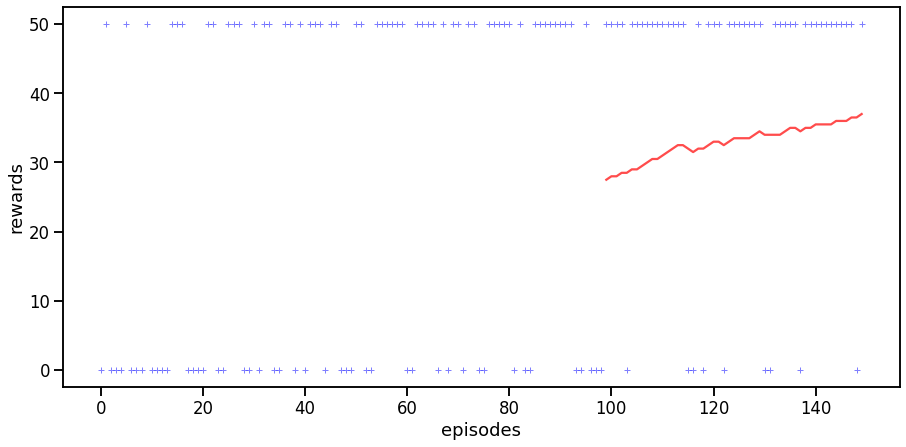

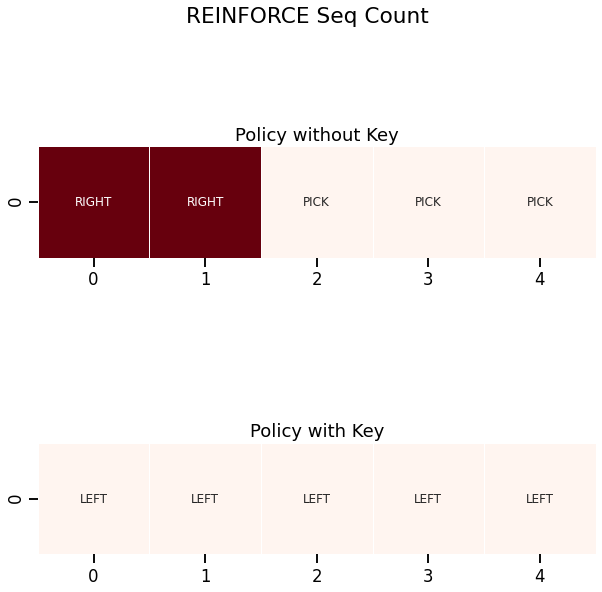

100.0

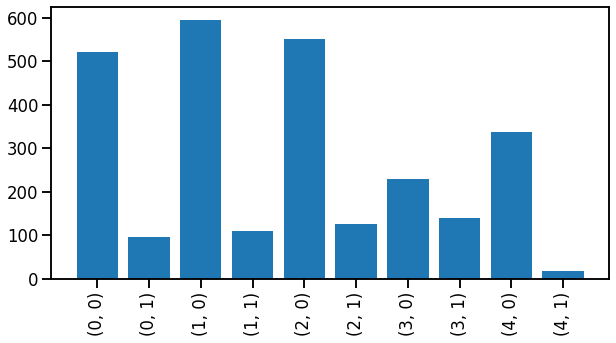

In [76]:
plot_scores(agent.scores, window_size=100)
agent.get_policy()
plot_policy(env, agent.pi, "REINFORCE Seq Count")
plot_state_freq(agent.state_freq)
agent.get_proba()
agent.get_space_visitation()

### Reinforce count staes + seq exploration

In [87]:
from rl_research.algorithms.reinforce_count_seq_states import train

In [88]:
agent = train(env, L, logs=logs)


****************************************************************************************************
TRAINING START


Iteration:  0
(0, 0) probas:  [0.33 0.33 0.33]
(0, 1) probas:  [0.36 0.31 0.33]
(1, 0) probas:  [0.34 0.33 0.33]
(1, 1) probas:  [0.36 0.3  0.34]
(2, 0) probas:  [0.34 0.32 0.34]
(2, 1) probas:  [0.36 0.29 0.35]
(3, 0) probas:  [0.35 0.32 0.34]
(3, 1) probas:  [0.36 0.29 0.36]
(4, 0) probas:  [0.35 0.31 0.34]
(4, 1) probas:  [0.35 0.28 0.36]
Score: 0
% of visited states: 40.0%

Iteration:  1
Score: 0
% of visited states: 40.0%

Iteration:  2
Score: 0
% of visited states: 50.0%

Iteration:  3
Score: 0
% of visited states: 70.0%

Iteration:  4
Score: 0
% of visited states: 70.0%

Iteration:  5
Score: 0
% of visited states: 70.0%

Iteration:  6
Score: 0
% of visited states: 70.0%

Iteration:  7
Score: 0
% of visited states: 70.0%

Iteration:  8
Score: 50
% of visited states: 80.0%

Iteration:  9
Score: 50
% of visited states: 100.0%

Iteration:  10
(0, 0) probas:  [0.35 0


Iteration:  91
Score: 0
% of visited states: 100.0%

Iteration:  92
Score: 0
% of visited states: 100.0%

Iteration:  93
Score: 0
% of visited states: 100.0%

Iteration:  94
Score: 50
% of visited states: 100.0%

Iteration:  95
Score: 0
% of visited states: 100.0%

Iteration:  96
Score: 50
% of visited states: 100.0%

Iteration:  97
Score: 0
% of visited states: 100.0%

Iteration:  98
Score: 0
% of visited states: 100.0%

Iteration:  99
Score: 50
% of visited states: 100.0%

Iteration:  100
(0, 0) probas:  [0.19 0.38 0.43]
(0, 1) probas:  [0.82 0.1  0.07]
(1, 0) probas:  [0.18 0.39 0.42]
(1, 1) probas:  [0.86 0.08 0.06]
(2, 0) probas:  [0.21 0.41 0.38]
(2, 1) probas:  [0.88 0.07 0.05]
(3, 0) probas:  [0.25 0.42 0.33]
(3, 1) probas:  [0.9  0.06 0.04]
(4, 0) probas:  [0.29 0.42 0.28]
(4, 1) probas:  [0.92 0.05 0.03]
Score: 0
% of visited states: 100.0%

Iteration:  101
Score: 50
% of visited states: 100.0%

Iteration:  102
Score: 50
% of visited states: 100.0%

Iteration:  103
Score: 50

<Figure size 720x360 with 0 Axes>

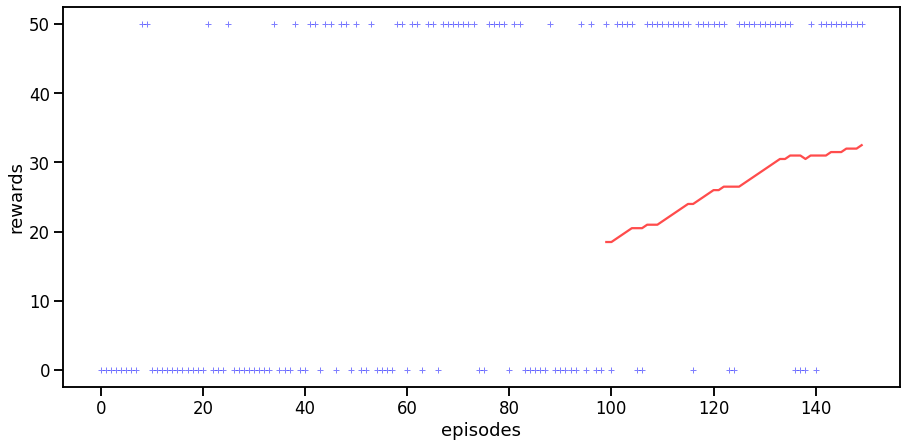

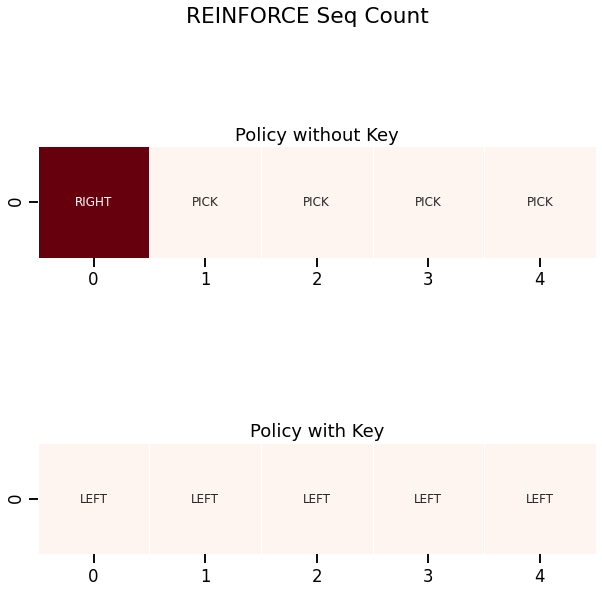

100.0

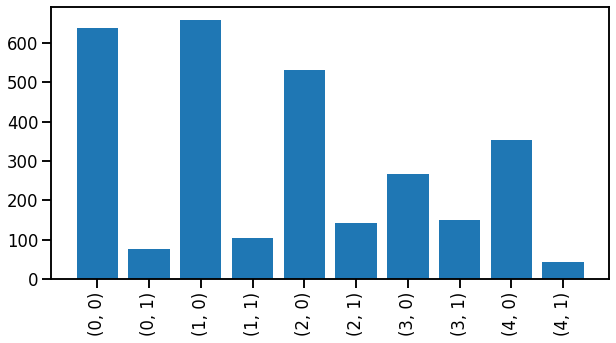

In [90]:
plot_scores(agent.scores)
agent.get_policy()
plot_policy(env, agent.pi, "REINFORCE Seq Count")
plot_state_freq(agent.state_freq)
agent.get_proba()

### NS ES

In [ ]:
# from NS_ES import train

In [ ]:
# agent = train(env)

### QD ES

In [ ]:
# npop = 40
# alpha = 0.1
# sigma = 1
# generation = 100

# K = 3
# archive = set()
# while len(archive) != K:
#     archive.add(QD_Agent().get_bc(env))

# agent = QD_Agent()


# print("\n"+"*"*100)
# print("TRAINING START\n")

# for gen in range(generation):
#     new_agents, N = create_pop(agent, npop=npop, sigma=sigma)
#     F = np.zeros(npop)
#     D = []
    
#     for i, n_a in enumerate(new_agents):
#         F[i] = n_a.evaluate(env)
#         D.append(n_a.get_bc(env)) 
    
# #     print(R)
    
#     nbrs = NearestNeighbors(n_neighbors=K, algorithm='ball_tree').fit(np.array(list(archive)))
#     D = np.mean(nbrs.kneighbors(np.array(R))[0], axis=1)

#     R = normalize_array(F) + normalize_array(D)
    
#     if np.std(R) == 0:
#         A = np.zeros(npop)
#     else:
#         A = (R - np.mean(R)) / np.std(R)
        
#     for key in agent.weights:
#         agent.weights[key] += alpha/(npop*sigma) * (N[key] @ A)
    
#     archive.add(agent.get_bc(env))
#     print(archive)
# #     print(agent.weights['w1'][0])
    
# #     print("Generation:", gen, "Score:", print(F))

# print("\n"+"*"*100)
# print("TRAINING ENDED\n")

In [ ]:
DQN testing

In [8]:
env = gym.make('keygrid-v0', grid_length=10)
from rl_research.algorithms import DQN
Agent= DQN.DQN_Agent(env)

You are using the KeyGridSparse environment with length 10


/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:175: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  "Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:191: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting.
  "Future gym versions will require that `Env.reset` can be passed `return_info` to return information from the environment resetting."
/home/rmapkay/aya_env/lib64/python3.6/site-packages/gym/utils/passive_env_checker.py:196: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed `options` to allow the en

v_array before reshaping  [[ 0.27312366  0.        ]
 [ 0.62345699 49.98595587]
 [ 1.32561747 47.37285857]
 [ 2.61932947 44.54788134]
 [ 4.79936639 41.11318039]
 [ 8.13996198 36.68695938]
 [12.76559283 31.16821299]
 [18.51476851 24.88868144]
 [ 0.          0.        ]
 [ 0.          0.        ]] shape  (10, 2)
after transpose  [[ 0.27312366  0.62345699  1.32561747  2.61932947  4.79936639  8.13996198
  12.76559283 18.51476851  0.          0.        ]
 [ 0.         49.98595587 47.37285857 44.54788134 41.11318039 36.68695938
  31.16821299 24.88868144  0.          0.        ]] shape  (2, 10)
final  [[[ 0.27312366  0.62345699  1.32561747  2.61932947  4.79936639
    8.13996198 12.76559283 18.51476851  0.          0.        ]]

 [[ 0.         49.98595587 47.37285857 44.54788134 41.11318039
   36.68695938 31.16821299 24.88868144  0.          0.        ]]] shape  (2, 1, 10)
hey  (1, 10)


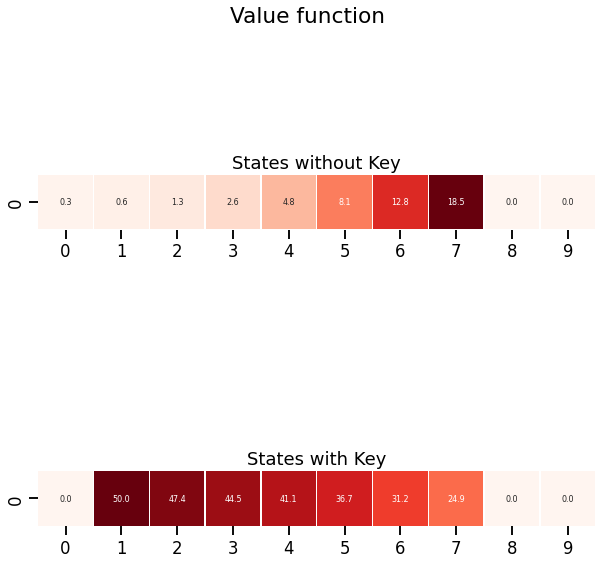

In [9]:
v_array = td_learning(env.opt_policy, env, display=False)
_ = plot_states(v_array, annot=v_array, title="Value function")

In [13]:
def train(agent, num_episodes):
    agent.train(num_episodes)
    return agent
num_episodes=8000
Agent=train(Agent,num_episodes)

khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1, 3), dtype=float32)
khara  tf.Tensor([[0. 0. 0.]], shape=(1,

<module 'matplotlib.pyplot' from '/home/rmapkay/aya_env/lib64/python3.6/site-packages/matplotlib/pyplot.py'>

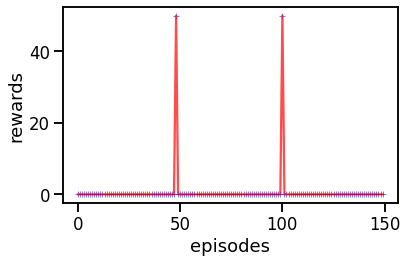

In [12]:
plot_scores(Agent.scores)

In [ ]:
res_r = pd.read_csv('data/reinforce_res.csv')
res_r_seq = pd.read_csv('data/reinforce_res_seq.csv')
res_r_st = pd.read_csv('data/reinforce_res_st.csv')


In [ ]:
np.sum(res_r_st > 49)>0

In [ ]:
np.sum(res_r_seq > 49)>0

In [1]:
losses=  [0.00015495543, 7.965964e-05, 3.0407675e-05, 6.98748e-05, 4.7352532e-05, 8.392439e-05, 6.633332e-05, 4.461685e-05, 3.2696073e-05, 2.042748e-05, 4.5755143e-05, 6.320107e-05, 4.9384333e-05, 2.2877695e-05, 1.0016063e-05, 2.404357e-05, 2.4758196e-05, 2.6271422e-05, 2.5957486e-05, 1.39027e-05]

In [ ]:
len(losses)

In [2]:
plt.plot(losses)

NameError: name 'plot' is not defined